# Session (475165_f1_stage2_day1)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f1_stage2_day1" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f1"
day = "day1"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (32771, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


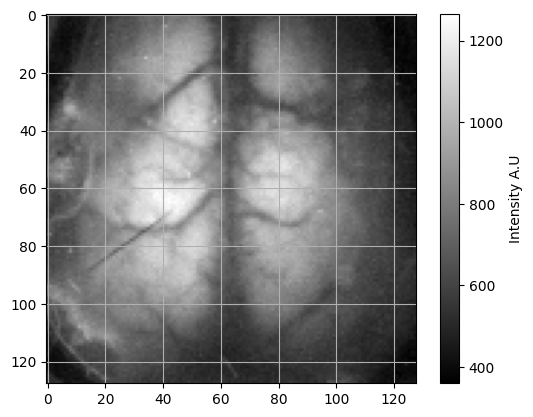

frame number 6000 plotted


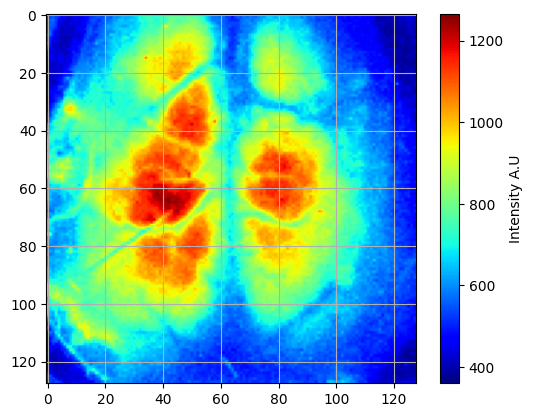

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 433.6884521484375 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 487.8995086669922


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 80
Number of double_flash pairs: 40
Number of single_flash: 38
Number of total flashes: 118


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/118 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/118 [00:01<02:40,  1.37s/it]

  2%|█▍                                                                                | 2/118 [00:02<02:40,  1.38s/it]

  3%|██                                                                                | 3/118 [00:04<02:37,  1.37s/it]

  3%|██▊                                                                               | 4/118 [00:05<02:33,  1.35s/it]

  4%|███▍                                                                              | 5/118 [00:06<02:35,  1.37s/it]

  5%|████▏                                                                             | 6/118 [00:08<02:31,  1.35s/it]

  6%|████▊                                                                             | 7/118 [00:09<02:32,  1.37s/it]

  7%|█████▌                                                                            | 8/118 [00:10<02:31,  1.38s/it]

  8%|██████▎                                                                           | 9/118 [00:12<02:29,  1.37s/it]

  8%|██████▊                                                                          | 10/118 [00:13<02:27,  1.36s/it]

  9%|███████▌                                                                         | 11/118 [00:14<02:24,  1.35s/it]

 10%|████████▏                                                                        | 12/118 [00:16<02:22,  1.35s/it]

 11%|████████▉                                                                        | 13/118 [00:17<02:19,  1.33s/it]

 12%|█████████▌                                                                       | 14/118 [00:19<02:20,  1.35s/it]

 13%|██████████▎                                                                      | 15/118 [00:20<02:18,  1.35s/it]

 14%|██████████▉                                                                      | 16/118 [00:21<02:18,  1.36s/it]

 14%|███████████▋                                                                     | 17/118 [00:23<02:14,  1.33s/it]

 15%|████████████▎                                                                    | 18/118 [00:24<02:16,  1.36s/it]

 16%|█████████████                                                                    | 19/118 [00:25<02:14,  1.36s/it]

 17%|█████████████▋                                                                   | 20/118 [00:27<02:12,  1.35s/it]

 18%|██████████████▍                                                                  | 21/118 [00:28<02:12,  1.37s/it]

 19%|███████████████                                                                  | 22/118 [00:29<02:07,  1.33s/it]

 19%|███████████████▊                                                                 | 23/118 [00:31<02:04,  1.31s/it]

 20%|████████████████▍                                                                | 24/118 [00:32<02:00,  1.28s/it]

 21%|█████████████████▏                                                               | 25/118 [00:33<02:01,  1.31s/it]

 22%|█████████████████▊                                                               | 26/118 [00:34<02:01,  1.32s/it]

 23%|██████████████████▌                                                              | 27/118 [00:36<01:59,  1.31s/it]

 24%|███████████████████▏                                                             | 28/118 [00:37<02:01,  1.35s/it]

 25%|███████████████████▉                                                             | 29/118 [00:39<01:59,  1.34s/it]

 25%|████████████████████▌                                                            | 30/118 [00:40<01:57,  1.34s/it]

 26%|█████████████████████▎                                                           | 31/118 [00:41<01:57,  1.35s/it]

 27%|█████████████████████▉                                                           | 32/118 [00:43<01:56,  1.36s/it]

 28%|██████████████████████▋                                                          | 33/118 [00:44<01:56,  1.38s/it]

 29%|███████████████████████▎                                                         | 34/118 [00:45<01:56,  1.39s/it]

 30%|████████████████████████                                                         | 35/118 [00:47<01:52,  1.35s/it]

 31%|████████████████████████▋                                                        | 36/118 [00:48<01:50,  1.35s/it]

 31%|█████████████████████████▍                                                       | 37/118 [00:50<01:52,  1.39s/it]

 32%|██████████████████████████                                                       | 38/118 [00:51<01:51,  1.40s/it]

 33%|██████████████████████████▊                                                      | 39/118 [00:52<01:48,  1.37s/it]

 34%|███████████████████████████▍                                                     | 40/118 [00:54<01:47,  1.38s/it]

 35%|████████████████████████████▏                                                    | 41/118 [00:55<01:45,  1.38s/it]

 36%|████████████████████████████▊                                                    | 42/118 [00:56<01:45,  1.38s/it]

 36%|█████████████████████████████▌                                                   | 43/118 [00:58<01:43,  1.38s/it]

 37%|██████████████████████████████▏                                                  | 44/118 [00:59<01:40,  1.35s/it]

 38%|██████████████████████████████▉                                                  | 45/118 [01:00<01:39,  1.36s/it]

 39%|███████████████████████████████▌                                                 | 46/118 [01:02<01:36,  1.35s/it]

 40%|████████████████████████████████▎                                                | 47/118 [01:03<01:36,  1.36s/it]

 41%|████████████████████████████████▉                                                | 48/118 [01:05<01:36,  1.38s/it]

 42%|█████████████████████████████████▋                                               | 49/118 [01:06<01:35,  1.38s/it]

 42%|██████████████████████████████████▎                                              | 50/118 [01:07<01:34,  1.38s/it]

 43%|███████████████████████████████████                                              | 51/118 [01:09<01:33,  1.39s/it]

 44%|███████████████████████████████████▋                                             | 52/118 [01:10<01:35,  1.44s/it]

 45%|████████████████████████████████████▍                                            | 53/118 [01:12<01:29,  1.38s/it]

 46%|█████████████████████████████████████                                            | 54/118 [01:13<01:28,  1.38s/it]

 47%|█████████████████████████████████████▊                                           | 55/118 [01:14<01:25,  1.36s/it]

 47%|██████████████████████████████████████▍                                          | 56/118 [01:16<01:24,  1.36s/it]

 48%|███████████████████████████████████████▏                                         | 57/118 [01:17<01:23,  1.37s/it]

 49%|███████████████████████████████████████▊                                         | 58/118 [01:18<01:22,  1.37s/it]

 50%|████████████████████████████████████████▌                                        | 59/118 [01:20<01:23,  1.41s/it]

 51%|█████████████████████████████████████████▏                                       | 60/118 [01:21<01:21,  1.41s/it]

 52%|█████████████████████████████████████████▊                                       | 61/118 [01:23<01:20,  1.41s/it]

 53%|██████████████████████████████████████████▌                                      | 62/118 [01:24<01:18,  1.40s/it]

 53%|███████████████████████████████████████████▏                                     | 63/118 [01:26<01:17,  1.41s/it]

 54%|███████████████████████████████████████████▉                                     | 64/118 [01:27<01:14,  1.38s/it]

 55%|████████████████████████████████████████████▌                                    | 65/118 [01:28<01:13,  1.39s/it]

 56%|█████████████████████████████████████████████▎                                   | 66/118 [01:30<01:10,  1.35s/it]

 57%|█████████████████████████████████████████████▉                                   | 67/118 [01:31<01:09,  1.36s/it]

 58%|██████████████████████████████████████████████▋                                  | 68/118 [01:32<01:08,  1.37s/it]

 58%|███████████████████████████████████████████████▎                                 | 69/118 [01:34<01:06,  1.36s/it]

 59%|████████████████████████████████████████████████                                 | 70/118 [01:35<01:04,  1.35s/it]

 60%|████████████████████████████████████████████████▋                                | 71/118 [01:36<01:05,  1.40s/it]

 61%|█████████████████████████████████████████████████▍                               | 72/118 [01:38<01:03,  1.37s/it]

 62%|██████████████████████████████████████████████████                               | 73/118 [01:39<01:00,  1.35s/it]

 63%|██████████████████████████████████████████████████▊                              | 74/118 [01:40<01:00,  1.36s/it]

 64%|███████████████████████████████████████████████████▍                             | 75/118 [01:42<00:59,  1.38s/it]

 64%|████████████████████████████████████████████████████▏                            | 76/118 [01:43<00:58,  1.39s/it]

 65%|████████████████████████████████████████████████████▊                            | 77/118 [01:45<00:55,  1.36s/it]

 66%|█████████████████████████████████████████████████████▌                           | 78/118 [01:46<00:52,  1.32s/it]

 67%|██████████████████████████████████████████████████████▏                          | 79/118 [01:47<00:51,  1.31s/it]

 68%|██████████████████████████████████████████████████████▉                          | 80/118 [01:48<00:49,  1.31s/it]

 69%|███████████████████████████████████████████████████████▌                         | 81/118 [01:50<00:48,  1.31s/it]

 69%|████████████████████████████████████████████████████████▎                        | 82/118 [01:51<00:47,  1.31s/it]

 70%|████████████████████████████████████████████████████████▉                        | 83/118 [01:52<00:46,  1.32s/it]

 71%|█████████████████████████████████████████████████████████▋                       | 84/118 [01:54<00:44,  1.31s/it]

 72%|██████████████████████████████████████████████████████████▎                      | 85/118 [01:55<00:42,  1.30s/it]

 73%|███████████████████████████████████████████████████████████                      | 86/118 [01:56<00:41,  1.31s/it]

 74%|███████████████████████████████████████████████████████████▋                     | 87/118 [01:58<00:40,  1.32s/it]

 75%|████████████████████████████████████████████████████████████▍                    | 88/118 [01:59<00:39,  1.32s/it]

 75%|█████████████████████████████████████████████████████████████                    | 89/118 [02:00<00:38,  1.33s/it]

 76%|█████████████████████████████████████████████████████████████▊                   | 90/118 [02:02<00:37,  1.34s/it]

 77%|██████████████████████████████████████████████████████████████▍                  | 91/118 [02:03<00:35,  1.32s/it]

 78%|███████████████████████████████████████████████████████████████▏                 | 92/118 [02:04<00:35,  1.38s/it]

 79%|███████████████████████████████████████████████████████████████▊                 | 93/118 [02:06<00:34,  1.37s/it]

 80%|████████████████████████████████████████████████████████████████▌                | 94/118 [02:07<00:32,  1.37s/it]

 81%|█████████████████████████████████████████████████████████████████▏               | 95/118 [02:08<00:31,  1.35s/it]

 81%|█████████████████████████████████████████████████████████████████▉               | 96/118 [02:10<00:30,  1.37s/it]

 82%|██████████████████████████████████████████████████████████████████▌              | 97/118 [02:11<00:29,  1.40s/it]

 83%|███████████████████████████████████████████████████████████████████▎             | 98/118 [02:13<00:28,  1.41s/it]

 84%|███████████████████████████████████████████████████████████████████▉             | 99/118 [02:14<00:26,  1.38s/it]

 85%|███████████████████████████████████████████████████████████████████▊            | 100/118 [02:15<00:24,  1.35s/it]

 86%|████████████████████████████████████████████████████████████████████▍           | 101/118 [02:17<00:22,  1.35s/it]

 86%|█████████████████████████████████████████████████████████████████████▏          | 102/118 [02:18<00:21,  1.34s/it]

 87%|█████████████████████████████████████████████████████████████████████▊          | 103/118 [02:19<00:20,  1.37s/it]

 88%|██████████████████████████████████████████████████████████████████████▌         | 104/118 [02:21<00:19,  1.38s/it]

 89%|███████████████████████████████████████████████████████████████████████▏        | 105/118 [02:22<00:18,  1.40s/it]

 90%|███████████████████████████████████████████████████████████████████████▊        | 106/118 [02:24<00:16,  1.40s/it]

 91%|████████████████████████████████████████████████████████████████████████▌       | 107/118 [02:25<00:15,  1.42s/it]

 92%|█████████████████████████████████████████████████████████████████████████▏      | 108/118 [02:27<00:13,  1.38s/it]

 92%|█████████████████████████████████████████████████████████████████████████▉      | 109/118 [02:28<00:12,  1.40s/it]

 93%|██████████████████████████████████████████████████████████████████████████▌     | 110/118 [02:29<00:10,  1.37s/it]

 94%|███████████████████████████████████████████████████████████████████████████▎    | 111/118 [02:31<00:09,  1.34s/it]

 95%|███████████████████████████████████████████████████████████████████████████▉    | 112/118 [02:32<00:08,  1.36s/it]

 96%|████████████████████████████████████████████████████████████████████████████▌   | 113/118 [02:33<00:06,  1.36s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▎  | 114/118 [02:35<00:05,  1.37s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▉  | 115/118 [02:36<00:04,  1.39s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▋ | 116/118 [02:37<00:02,  1.35s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▎| 117/118 [02:39<00:01,  1.32s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 118/118 [02:40<00:00,  1.34s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 118/118 [02:40<00:00,  1.36s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 20%|████████████████▎                                                               | 26/128 [00:00<00:00, 244.41it/s]

 40%|███████████████████████████████▉                                                | 51/128 [00:00<00:00, 246.32it/s]

 59%|███████████████████████████████████████████████▌                                | 76/128 [00:00<00:00, 239.41it/s]

 80%|███████████████████████████████████████████████████████████████▌               | 103/128 [00:00<00:00, 246.88it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 249.17it/s]

  0%|                                                                                        | 0/32149 [00:00<?, ?it/s]

  0%|                                                                              | 26/32149 [00:00<02:04, 257.51it/s]

  0%|▏                                                                             | 52/32149 [00:00<02:04, 258.25it/s]

  0%|▏                                                                             | 78/32149 [00:00<02:11, 244.62it/s]

  0%|▏                                                                            | 103/32149 [00:00<02:26, 219.19it/s]

  0%|▎                                                                            | 127/32149 [00:00<02:22, 224.53it/s]

  0%|▎                                                                            | 150/32149 [00:00<02:25, 219.35it/s]

  1%|▍                                                                            | 177/32149 [00:00<02:17, 231.97it/s]

  1%|▍                                                                            | 201/32149 [00:00<02:22, 224.30it/s]

  1%|▌                                                                            | 224/32149 [00:00<02:27, 217.13it/s]

  1%|▌                                                                            | 250/32149 [00:01<02:20, 227.76it/s]

  1%|▋                                                                            | 274/32149 [00:01<02:19, 228.68it/s]

  1%|▋                                                                            | 299/32149 [00:01<02:15, 234.19it/s]

  1%|▊                                                                            | 328/32149 [00:01<02:07, 249.06it/s]

  1%|▊                                                                            | 354/32149 [00:01<02:06, 251.55it/s]

  1%|▉                                                                            | 380/32149 [00:01<02:08, 246.80it/s]

  1%|▉                                                                            | 407/32149 [00:01<02:05, 252.82it/s]

  1%|█                                                                            | 434/32149 [00:01<02:04, 255.63it/s]

  1%|█                                                                            | 461/32149 [00:01<02:02, 258.35it/s]

  2%|█▏                                                                           | 487/32149 [00:02<02:02, 258.10it/s]

  2%|█▏                                                                           | 514/32149 [00:02<02:01, 259.34it/s]

  2%|█▎                                                                           | 540/32149 [00:02<02:03, 255.09it/s]

  2%|█▎                                                                           | 566/32149 [00:02<02:06, 248.70it/s]

  2%|█▍                                                                           | 592/32149 [00:02<02:05, 251.61it/s]

  2%|█▍                                                                           | 620/32149 [00:02<02:02, 258.40it/s]

  2%|█▌                                                                           | 646/32149 [00:02<02:14, 234.52it/s]

  2%|█▌                                                                           | 672/32149 [00:02<02:10, 240.88it/s]

  2%|█▋                                                                           | 699/32149 [00:02<02:06, 248.40it/s]

  2%|█▋                                                                           | 726/32149 [00:02<02:04, 252.44it/s]

  2%|█▊                                                                           | 752/32149 [00:03<02:06, 247.51it/s]

  2%|█▊                                                                           | 777/32149 [00:03<02:07, 245.44it/s]

  2%|█▉                                                                           | 803/32149 [00:03<02:05, 248.94it/s]

  3%|█▉                                                                           | 828/32149 [00:03<02:09, 242.23it/s]

  3%|██                                                                           | 857/32149 [00:03<02:02, 254.53it/s]

  3%|██                                                                           | 883/32149 [00:03<02:06, 246.84it/s]

  3%|██▏                                                                          | 910/32149 [00:03<02:03, 252.75it/s]

  3%|██▏                                                                          | 937/32149 [00:03<02:02, 254.81it/s]

  3%|██▎                                                                          | 963/32149 [00:03<02:04, 250.53it/s]

  3%|██▎                                                                          | 989/32149 [00:04<02:07, 244.14it/s]

  3%|██▍                                                                         | 1015/32149 [00:04<02:06, 245.81it/s]

  3%|██▍                                                                         | 1043/32149 [00:04<02:03, 252.73it/s]

  3%|██▌                                                                         | 1070/32149 [00:04<02:01, 255.52it/s]

  3%|██▌                                                                         | 1096/32149 [00:04<02:01, 254.63it/s]

  3%|██▋                                                                         | 1122/32149 [00:04<02:04, 248.27it/s]

  4%|██▋                                                                         | 1149/32149 [00:04<02:02, 253.08it/s]

  4%|██▊                                                                         | 1175/32149 [00:04<02:04, 249.32it/s]

  4%|██▊                                                                         | 1200/32149 [00:04<02:06, 245.30it/s]

  4%|██▉                                                                         | 1225/32149 [00:05<02:10, 237.12it/s]

  4%|██▉                                                                         | 1250/32149 [00:05<02:09, 238.76it/s]

  4%|███                                                                         | 1279/32149 [00:05<02:02, 251.31it/s]

  4%|███                                                                         | 1305/32149 [00:05<02:06, 242.95it/s]

  4%|███▏                                                                        | 1334/32149 [00:05<02:00, 255.61it/s]

  4%|███▏                                                                        | 1360/32149 [00:05<02:00, 254.86it/s]

  4%|███▎                                                                        | 1389/32149 [00:05<01:56, 264.29it/s]

  4%|███▎                                                                        | 1418/32149 [00:05<01:53, 270.25it/s]

  5%|███▍                                                                        | 1447/32149 [00:05<01:52, 272.87it/s]

  5%|███▍                                                                        | 1475/32149 [00:05<01:55, 266.41it/s]

  5%|███▌                                                                        | 1503/32149 [00:06<01:54, 267.64it/s]

  5%|███▌                                                                        | 1532/32149 [00:06<01:52, 272.57it/s]

  5%|███▋                                                                        | 1560/32149 [00:06<02:00, 253.68it/s]

  5%|███▊                                                                        | 1588/32149 [00:06<01:58, 258.86it/s]

  5%|███▊                                                                        | 1615/32149 [00:06<02:05, 242.83it/s]

  5%|███▉                                                                        | 1642/32149 [00:06<02:03, 247.56it/s]

  5%|███▉                                                                        | 1669/32149 [00:06<02:01, 251.03it/s]

  5%|████                                                                        | 1695/32149 [00:06<02:00, 252.87it/s]

  5%|████                                                                        | 1722/32149 [00:06<01:59, 255.60it/s]

  5%|████▏                                                                       | 1748/32149 [00:07<02:00, 253.24it/s]

  6%|████▏                                                                       | 1776/32149 [00:07<01:57, 259.50it/s]

  6%|████▎                                                                       | 1803/32149 [00:07<02:00, 250.90it/s]

  6%|████▎                                                                       | 1829/32149 [00:07<01:59, 252.79it/s]

  6%|████▍                                                                       | 1856/32149 [00:07<01:58, 256.30it/s]

  6%|████▍                                                                       | 1883/32149 [00:07<01:57, 257.32it/s]

  6%|████▌                                                                       | 1910/32149 [00:07<01:57, 258.35it/s]

  6%|████▌                                                                       | 1936/32149 [00:07<01:57, 258.11it/s]

  6%|████▋                                                                       | 1962/32149 [00:07<02:00, 250.60it/s]

  6%|████▋                                                                       | 1988/32149 [00:07<02:00, 249.73it/s]

  6%|████▊                                                                       | 2014/32149 [00:08<02:00, 250.55it/s]

  6%|████▊                                                                       | 2042/32149 [00:08<01:57, 256.16it/s]

  6%|████▉                                                                       | 2068/32149 [00:08<02:00, 250.19it/s]

  7%|████▉                                                                       | 2095/32149 [00:08<01:58, 253.73it/s]

  7%|█████                                                                       | 2121/32149 [00:08<01:59, 250.25it/s]

  7%|█████                                                                       | 2147/32149 [00:08<02:05, 238.64it/s]

  7%|█████▏                                                                      | 2175/32149 [00:08<02:01, 247.46it/s]

  7%|█████▏                                                                      | 2200/32149 [00:08<02:03, 242.04it/s]

  7%|█████▎                                                                      | 2228/32149 [00:08<01:59, 249.98it/s]

  7%|█████▎                                                                      | 2254/32149 [00:09<02:00, 247.91it/s]

  7%|█████▍                                                                      | 2279/32149 [00:09<02:05, 237.67it/s]

  7%|█████▍                                                                      | 2303/32149 [00:09<02:05, 237.01it/s]

  7%|█████▌                                                                      | 2330/32149 [00:09<02:02, 244.35it/s]

  7%|█████▌                                                                      | 2357/32149 [00:09<01:59, 248.89it/s]

  7%|█████▋                                                                      | 2386/32149 [00:09<01:54, 260.05it/s]

  8%|█████▋                                                                      | 2413/32149 [00:09<02:00, 247.12it/s]

  8%|█████▊                                                                      | 2441/32149 [00:09<01:56, 254.25it/s]

  8%|█████▊                                                                      | 2468/32149 [00:09<01:55, 258.03it/s]

  8%|█████▉                                                                      | 2495/32149 [00:09<01:53, 260.76it/s]

  8%|█████▉                                                                      | 2522/32149 [00:10<01:56, 255.30it/s]

  8%|██████                                                                      | 2550/32149 [00:10<01:53, 260.18it/s]

  8%|██████                                                                      | 2577/32149 [00:10<01:54, 258.92it/s]

  8%|██████▏                                                                     | 2604/32149 [00:10<01:53, 259.90it/s]

  8%|██████▏                                                                     | 2631/32149 [00:10<01:52, 262.10it/s]

  8%|██████▎                                                                     | 2658/32149 [00:10<02:00, 245.74it/s]

  8%|██████▎                                                                     | 2685/32149 [00:10<01:57, 250.45it/s]

  8%|██████▍                                                                     | 2711/32149 [00:10<01:56, 251.76it/s]

  9%|██████▍                                                                     | 2738/32149 [00:10<01:55, 254.10it/s]

  9%|██████▌                                                                     | 2765/32149 [00:11<01:54, 257.23it/s]

  9%|██████▌                                                                     | 2792/32149 [00:11<01:53, 259.46it/s]

  9%|██████▋                                                                     | 2821/32149 [00:11<01:50, 265.32it/s]

  9%|██████▋                                                                     | 2849/32149 [00:11<01:49, 268.48it/s]

  9%|██████▊                                                                     | 2877/32149 [00:11<01:48, 270.13it/s]

  9%|██████▊                                                                     | 2906/32149 [00:11<01:46, 273.69it/s]

  9%|██████▉                                                                     | 2934/32149 [00:11<01:54, 254.61it/s]

  9%|██████▉                                                                     | 2960/32149 [00:11<01:55, 251.91it/s]

  9%|███████                                                                     | 2987/32149 [00:11<01:53, 256.32it/s]

  9%|███████                                                                     | 3013/32149 [00:12<01:57, 247.47it/s]

  9%|███████▏                                                                    | 3040/32149 [00:12<01:54, 253.14it/s]

 10%|███████▎                                                                    | 3067/32149 [00:12<01:53, 255.80it/s]

 10%|███████▎                                                                    | 3093/32149 [00:12<01:57, 247.74it/s]

 10%|███████▎                                                                    | 3119/32149 [00:12<01:56, 249.12it/s]

 10%|███████▍                                                                    | 3147/32149 [00:12<01:53, 256.55it/s]

 10%|███████▌                                                                    | 3175/32149 [00:12<01:51, 259.23it/s]

 10%|███████▌                                                                    | 3201/32149 [00:12<01:54, 251.82it/s]

 10%|███████▋                                                                    | 3228/32149 [00:12<01:52, 256.32it/s]

 10%|███████▋                                                                    | 3254/32149 [00:12<01:57, 246.69it/s]

 10%|███████▊                                                                    | 3283/32149 [00:13<01:52, 256.83it/s]

 10%|███████▊                                                                    | 3311/32149 [00:13<01:50, 262.00it/s]

 10%|███████▉                                                                    | 3340/32149 [00:13<01:47, 267.81it/s]

 10%|███████▉                                                                    | 3367/32149 [00:13<01:47, 267.69it/s]

 11%|████████                                                                    | 3395/32149 [00:13<01:47, 268.19it/s]

 11%|████████                                                                    | 3423/32149 [00:13<01:46, 270.09it/s]

 11%|████████▏                                                                   | 3451/32149 [00:13<01:51, 257.17it/s]

 11%|████████▏                                                                   | 3477/32149 [00:13<01:54, 250.89it/s]

 11%|████████▎                                                                   | 3503/32149 [00:13<01:54, 249.96it/s]

 11%|████████▎                                                                   | 3529/32149 [00:14<02:00, 237.95it/s]

 11%|████████▍                                                                   | 3553/32149 [00:14<02:01, 235.93it/s]

 11%|████████▍                                                                   | 3577/32149 [00:14<02:02, 232.32it/s]

 11%|████████▌                                                                   | 3601/32149 [00:14<02:03, 231.00it/s]

 11%|████████▌                                                                   | 3626/32149 [00:14<02:00, 235.76it/s]

 11%|████████▋                                                                   | 3653/32149 [00:14<01:56, 243.61it/s]

 11%|████████▋                                                                   | 3680/32149 [00:14<01:53, 251.18it/s]

 12%|████████▊                                                                   | 3706/32149 [00:14<01:56, 245.17it/s]

 12%|████████▊                                                                   | 3735/32149 [00:14<01:51, 255.89it/s]

 12%|████████▉                                                                   | 3763/32149 [00:14<01:48, 260.64it/s]

 12%|████████▉                                                                   | 3791/32149 [00:15<01:47, 264.37it/s]

 12%|█████████                                                                   | 3820/32149 [00:15<01:44, 270.30it/s]

 12%|█████████                                                                   | 3848/32149 [00:15<01:46, 265.39it/s]

 12%|█████████▏                                                                  | 3875/32149 [00:15<01:46, 265.98it/s]

 12%|█████████▏                                                                  | 3904/32149 [00:15<01:43, 272.22it/s]

 12%|█████████▎                                                                  | 3932/32149 [00:15<01:49, 257.88it/s]

 12%|█████████▎                                                                  | 3958/32149 [00:15<01:56, 242.08it/s]

 12%|█████████▍                                                                  | 3985/32149 [00:15<01:53, 249.08it/s]

 12%|█████████▍                                                                  | 4012/32149 [00:15<01:51, 252.15it/s]

 13%|█████████▌                                                                  | 4038/32149 [00:16<01:54, 245.34it/s]

 13%|█████████▌                                                                  | 4065/32149 [00:16<01:52, 250.19it/s]

 13%|█████████▋                                                                  | 4093/32149 [00:16<01:49, 255.80it/s]

 13%|█████████▋                                                                  | 4120/32149 [00:16<01:49, 256.95it/s]

 13%|█████████▊                                                                  | 4146/32149 [00:16<01:52, 249.93it/s]

 13%|█████████▊                                                                  | 4173/32149 [00:16<01:49, 254.95it/s]

 13%|█████████▉                                                                  | 4199/32149 [00:16<01:51, 251.35it/s]

 13%|█████████▉                                                                  | 4228/32149 [00:16<01:46, 261.01it/s]

 13%|██████████                                                                  | 4255/32149 [00:16<01:51, 251.25it/s]

 13%|██████████                                                                  | 4282/32149 [00:17<01:49, 254.42it/s]

 13%|██████████▏                                                                 | 4310/32149 [00:17<01:46, 260.28it/s]

 13%|██████████▎                                                                 | 4337/32149 [00:17<01:53, 246.04it/s]

 14%|██████████▎                                                                 | 4362/32149 [00:17<01:55, 241.12it/s]

 14%|██████████▎                                                                 | 4388/32149 [00:17<01:52, 245.88it/s]

 14%|██████████▍                                                                 | 4415/32149 [00:17<01:50, 250.56it/s]

 14%|██████████▍                                                                 | 4441/32149 [00:17<01:51, 247.97it/s]

 14%|██████████▌                                                                 | 4466/32149 [00:17<01:52, 247.16it/s]

 14%|██████████▌                                                                 | 4493/32149 [00:17<01:49, 252.34it/s]

 14%|██████████▋                                                                 | 4519/32149 [00:17<01:51, 248.80it/s]

 14%|██████████▋                                                                 | 4544/32149 [00:18<01:52, 244.92it/s]

 14%|██████████▊                                                                 | 4569/32149 [00:18<01:56, 237.50it/s]

 14%|██████████▊                                                                 | 4596/32149 [00:18<01:51, 246.54it/s]

 14%|██████████▉                                                                 | 4621/32149 [00:18<01:52, 244.96it/s]

 14%|██████████▉                                                                 | 4650/32149 [00:18<01:47, 256.56it/s]

 15%|███████████                                                                 | 4679/32149 [00:18<01:43, 264.80it/s]

 15%|███████████                                                                 | 4706/32149 [00:18<01:43, 265.57it/s]

 15%|███████████▏                                                                | 4733/32149 [00:18<01:43, 263.79it/s]

 15%|███████████▎                                                                | 4760/32149 [00:18<01:52, 242.83it/s]

 15%|███████████▎                                                                | 4785/32149 [00:19<01:53, 242.16it/s]

 15%|███████████▎                                                                | 4810/32149 [00:19<01:59, 229.53it/s]

 15%|███████████▍                                                                | 4836/32149 [00:19<01:55, 237.26it/s]

 15%|███████████▍                                                                | 4860/32149 [00:19<01:58, 230.92it/s]

 15%|███████████▌                                                                | 4887/32149 [00:19<01:53, 241.21it/s]

 15%|███████████▌                                                                | 4914/32149 [00:19<01:49, 249.38it/s]

 15%|███████████▋                                                                | 4941/32149 [00:19<01:47, 252.53it/s]

 15%|███████████▋                                                                | 4970/32149 [00:19<01:44, 261.16it/s]

 16%|███████████▊                                                                | 4997/32149 [00:19<01:44, 259.23it/s]

 16%|███████████▊                                                                | 5023/32149 [00:20<01:48, 250.74it/s]

 16%|███████████▉                                                                | 5049/32149 [00:20<01:48, 250.55it/s]

 16%|███████████▉                                                                | 5075/32149 [00:20<01:49, 246.21it/s]

 16%|████████████                                                                | 5100/32149 [00:20<01:53, 237.44it/s]

 16%|████████████                                                                | 5125/32149 [00:20<01:52, 239.37it/s]

 16%|████████████▏                                                               | 5149/32149 [00:20<01:54, 235.13it/s]

 16%|████████████▏                                                               | 5175/32149 [00:20<01:51, 241.57it/s]

 16%|████████████▎                                                               | 5200/32149 [00:20<01:54, 234.54it/s]

 16%|████████████▎                                                               | 5224/32149 [00:20<01:55, 233.46it/s]

 16%|████████████▍                                                               | 5252/32149 [00:20<01:50, 244.02it/s]

 16%|████████████▍                                                               | 5278/32149 [00:21<01:48, 247.23it/s]

 16%|████████████▌                                                               | 5303/32149 [00:21<01:51, 241.74it/s]

 17%|████████████▌                                                               | 5328/32149 [00:21<01:50, 243.44it/s]

 17%|████████████▋                                                               | 5353/32149 [00:21<01:49, 243.95it/s]

 17%|████████████▋                                                               | 5378/32149 [00:21<01:49, 243.61it/s]

 17%|████████████▊                                                               | 5403/32149 [00:21<01:55, 232.24it/s]

 17%|████████████▊                                                               | 5428/32149 [00:21<01:53, 235.30it/s]

 17%|████████████▉                                                               | 5456/32149 [00:21<01:48, 245.32it/s]

 17%|████████████▉                                                               | 5483/32149 [00:21<01:46, 251.01it/s]

 17%|█████████████                                                               | 5509/32149 [00:22<01:47, 247.89it/s]

 17%|█████████████                                                               | 5537/32149 [00:22<01:44, 254.24it/s]

 17%|█████████████▏                                                              | 5564/32149 [00:22<01:43, 255.87it/s]

 17%|█████████████▏                                                              | 5590/32149 [00:22<01:44, 254.87it/s]

 17%|█████████████▎                                                              | 5618/32149 [00:22<01:42, 259.57it/s]

 18%|█████████████▎                                                              | 5646/32149 [00:22<01:40, 264.02it/s]

 18%|█████████████▍                                                              | 5673/32149 [00:22<01:39, 265.02it/s]

 18%|█████████████▍                                                              | 5700/32149 [00:22<01:43, 255.24it/s]

 18%|█████████████▌                                                              | 5726/32149 [00:22<01:43, 254.44it/s]

 18%|█████████████▌                                                              | 5755/32149 [00:22<01:40, 263.23it/s]

 18%|█████████████▋                                                              | 5782/32149 [00:23<01:42, 257.72it/s]

 18%|█████████████▋                                                              | 5809/32149 [00:23<01:41, 259.79it/s]

 18%|█████████████▊                                                              | 5836/32149 [00:23<01:41, 260.51it/s]

 18%|█████████████▊                                                              | 5863/32149 [00:23<01:45, 250.18it/s]

 18%|█████████████▉                                                              | 5889/32149 [00:23<01:44, 250.52it/s]

 18%|█████████████▉                                                              | 5916/32149 [00:23<01:43, 254.66it/s]

 18%|██████████████                                                              | 5944/32149 [00:23<01:40, 259.76it/s]

 19%|██████████████                                                              | 5973/32149 [00:23<01:38, 267.02it/s]

 19%|██████████████▏                                                             | 6002/32149 [00:23<01:36, 271.38it/s]

 19%|██████████████▎                                                             | 6031/32149 [00:24<01:35, 274.45it/s]

 19%|██████████████▎                                                             | 6059/32149 [00:24<01:36, 269.78it/s]

 19%|██████████████▍                                                             | 6087/32149 [00:24<01:43, 252.27it/s]

 19%|██████████████▍                                                             | 6116/32149 [00:24<01:39, 261.31it/s]

 19%|██████████████▌                                                             | 6143/32149 [00:24<01:39, 262.31it/s]

 19%|██████████████▌                                                             | 6170/32149 [00:24<01:39, 260.80it/s]

 19%|██████████████▋                                                             | 6199/32149 [00:24<01:37, 266.92it/s]

 19%|██████████████▋                                                             | 6226/32149 [00:24<01:37, 265.53it/s]

 19%|██████████████▊                                                             | 6253/32149 [00:24<01:40, 257.86it/s]

 20%|██████████████▊                                                             | 6280/32149 [00:24<01:39, 260.62it/s]

 20%|██████████████▉                                                             | 6308/32149 [00:25<01:37, 263.97it/s]

 20%|██████████████▉                                                             | 6337/32149 [00:25<01:35, 270.00it/s]

 20%|███████████████                                                             | 6365/32149 [00:25<01:36, 265.95it/s]

 20%|███████████████                                                             | 6392/32149 [00:25<01:40, 256.75it/s]

 20%|███████████████▏                                                            | 6419/32149 [00:25<01:39, 258.34it/s]

 20%|███████████████▏                                                            | 6445/32149 [00:25<01:42, 250.22it/s]

 20%|███████████████▎                                                            | 6472/32149 [00:25<01:40, 254.42it/s]

 20%|███████████████▎                                                            | 6499/32149 [00:25<01:39, 258.18it/s]

 20%|███████████████▍                                                            | 6527/32149 [00:25<01:37, 262.26it/s]

 20%|███████████████▍                                                            | 6554/32149 [00:26<01:37, 263.01it/s]

 20%|███████████████▌                                                            | 6582/32149 [00:26<01:36, 265.68it/s]

 21%|███████████████▋                                                            | 6610/32149 [00:26<01:35, 267.55it/s]

 21%|███████████████▋                                                            | 6637/32149 [00:26<01:42, 248.26it/s]

 21%|███████████████▊                                                            | 6663/32149 [00:26<01:41, 251.10it/s]

 21%|███████████████▊                                                            | 6689/32149 [00:26<01:40, 252.94it/s]

 21%|███████████████▊                                                            | 6715/32149 [00:26<01:40, 253.54it/s]

 21%|███████████████▉                                                            | 6741/32149 [00:26<01:47, 236.21it/s]

 21%|███████████████▉                                                            | 6765/32149 [00:26<01:48, 233.40it/s]

 21%|████████████████                                                            | 6792/32149 [00:26<01:44, 243.35it/s]

 21%|████████████████                                                            | 6817/32149 [00:27<01:43, 244.57it/s]

 21%|████████████████▏                                                           | 6844/32149 [00:27<01:41, 250.51it/s]

 21%|████████████████▏                                                           | 6871/32149 [00:27<01:38, 255.47it/s]

 21%|████████████████▎                                                           | 6899/32149 [00:27<01:36, 260.40it/s]

 22%|████████████████▎                                                           | 6926/32149 [00:27<01:36, 260.95it/s]

 22%|████████████████▍                                                           | 6954/32149 [00:27<01:35, 264.24it/s]

 22%|████████████████▌                                                           | 6981/32149 [00:27<01:35, 264.40it/s]

 22%|████████████████▌                                                           | 7008/32149 [00:27<01:38, 254.11it/s]

 22%|████████████████▋                                                           | 7035/32149 [00:27<01:37, 257.22it/s]

 22%|████████████████▋                                                           | 7061/32149 [00:28<01:37, 257.30it/s]

 22%|████████████████▊                                                           | 7089/32149 [00:28<01:35, 263.19it/s]

 22%|████████████████▊                                                           | 7117/32149 [00:28<01:33, 267.36it/s]

 22%|████████████████▉                                                           | 7145/32149 [00:28<01:32, 269.53it/s]

 22%|████████████████▉                                                           | 7172/32149 [00:28<01:33, 266.55it/s]

 22%|█████████████████                                                           | 7199/32149 [00:28<01:39, 250.63it/s]

 22%|█████████████████                                                           | 7228/32149 [00:28<01:36, 259.58it/s]

 23%|█████████████████▏                                                          | 7257/32149 [00:28<01:33, 266.02it/s]

 23%|█████████████████▏                                                          | 7284/32149 [00:28<01:34, 261.91it/s]

 23%|█████████████████▎                                                          | 7311/32149 [00:28<01:35, 260.52it/s]

 23%|█████████████████▎                                                          | 7340/32149 [00:29<01:33, 266.74it/s]

 23%|█████████████████▍                                                          | 7369/32149 [00:29<01:31, 270.37it/s]

 23%|█████████████████▍                                                          | 7397/32149 [00:29<01:38, 251.04it/s]

 23%|█████████████████▌                                                          | 7423/32149 [00:29<01:40, 245.41it/s]

 23%|█████████████████▌                                                          | 7448/32149 [00:29<01:44, 236.12it/s]

 23%|█████████████████▋                                                          | 7475/32149 [00:29<01:40, 245.01it/s]

 23%|█████████████████▋                                                          | 7502/32149 [00:29<01:37, 251.77it/s]

 23%|█████████████████▊                                                          | 7528/32149 [00:29<01:41, 242.36it/s]

 23%|█████████████████▊                                                          | 7555/32149 [00:29<01:38, 248.74it/s]

 24%|█████████████████▉                                                          | 7582/32149 [00:30<01:37, 252.67it/s]

 24%|█████████████████▉                                                          | 7609/32149 [00:30<01:35, 256.20it/s]

 24%|██████████████████                                                          | 7636/32149 [00:30<01:34, 259.48it/s]

 24%|██████████████████                                                          | 7663/32149 [00:30<01:37, 250.85it/s]

 24%|██████████████████▏                                                         | 7691/32149 [00:30<01:34, 257.72it/s]

 24%|██████████████████▏                                                         | 7718/32149 [00:30<01:33, 260.53it/s]

 24%|██████████████████▎                                                         | 7745/32149 [00:30<01:33, 261.79it/s]

 24%|██████████████████▎                                                         | 7772/32149 [00:30<01:34, 258.18it/s]

 24%|██████████████████▍                                                         | 7800/32149 [00:30<01:32, 263.01it/s]

 24%|██████████████████▌                                                         | 7827/32149 [00:31<01:37, 249.09it/s]

 24%|██████████████████▌                                                         | 7853/32149 [00:31<01:37, 248.68it/s]

 25%|██████████████████▌                                                         | 7878/32149 [00:31<01:38, 245.60it/s]

 25%|██████████████████▋                                                         | 7905/32149 [00:31<01:36, 250.45it/s]

 25%|██████████████████▋                                                         | 7931/32149 [00:31<01:38, 246.13it/s]

 25%|██████████████████▊                                                         | 7958/32149 [00:31<01:36, 251.54it/s]

 25%|██████████████████▉                                                         | 7985/32149 [00:31<01:34, 256.16it/s]

 25%|██████████████████▉                                                         | 8014/32149 [00:31<01:31, 264.51it/s]

 25%|███████████████████                                                         | 8041/32149 [00:31<01:36, 248.67it/s]

 25%|███████████████████                                                         | 8067/32149 [00:31<01:40, 239.75it/s]

 25%|███████████████████▏                                                        | 8093/32149 [00:32<01:38, 244.70it/s]

 25%|███████████████████▏                                                        | 8121/32149 [00:32<01:34, 253.27it/s]

 25%|███████████████████▎                                                        | 8147/32149 [00:32<01:34, 253.49it/s]

 25%|███████████████████▎                                                        | 8173/32149 [00:32<01:36, 248.02it/s]

 26%|███████████████████▍                                                        | 8198/32149 [00:32<01:37, 246.44it/s]

 26%|███████████████████▍                                                        | 8223/32149 [00:32<01:37, 244.27it/s]

 26%|███████████████████▍                                                        | 8248/32149 [00:32<01:39, 241.10it/s]

 26%|███████████████████▌                                                        | 8273/32149 [00:32<01:41, 235.54it/s]

 26%|███████████████████▌                                                        | 8297/32149 [00:32<01:44, 229.01it/s]

 26%|███████████████████▋                                                        | 8324/32149 [00:33<01:39, 239.93it/s]

 26%|███████████████████▋                                                        | 8351/32149 [00:33<01:36, 247.16it/s]

 26%|███████████████████▊                                                        | 8376/32149 [00:33<01:39, 239.01it/s]

 26%|███████████████████▊                                                        | 8404/32149 [00:33<01:35, 248.59it/s]

 26%|███████████████████▉                                                        | 8431/32149 [00:33<01:33, 254.04it/s]

 26%|███████████████████▉                                                        | 8459/32149 [00:33<01:31, 260.10it/s]

 26%|████████████████████                                                        | 8486/32149 [00:33<01:37, 242.48it/s]

 26%|████████████████████                                                        | 8511/32149 [00:33<01:38, 240.58it/s]

 27%|████████████████████▏                                                       | 8536/32149 [00:33<01:38, 240.55it/s]

 27%|████████████████████▏                                                       | 8562/32149 [00:34<01:36, 243.33it/s]

 27%|████████████████████▎                                                       | 8589/32149 [00:34<01:34, 249.56it/s]

 27%|████████████████████▎                                                       | 8615/32149 [00:34<01:36, 243.46it/s]

 27%|████████████████████▍                                                       | 8643/32149 [00:34<01:33, 251.74it/s]

 27%|████████████████████▍                                                       | 8670/32149 [00:34<01:32, 254.82it/s]

 27%|████████████████████▌                                                       | 8696/32149 [00:34<01:42, 229.75it/s]

 27%|████████████████████▌                                                       | 8723/32149 [00:34<01:37, 239.36it/s]

 27%|████████████████████▋                                                       | 8748/32149 [00:34<01:37, 239.68it/s]

 27%|████████████████████▋                                                       | 8776/32149 [00:34<01:33, 249.65it/s]

 27%|████████████████████▊                                                       | 8802/32149 [00:34<01:37, 239.63it/s]

 27%|████████████████████▊                                                       | 8829/32149 [00:35<01:35, 244.04it/s]

 28%|████████████████████▉                                                       | 8854/32149 [00:35<01:35, 244.37it/s]

 28%|████████████████████▉                                                       | 8879/32149 [00:35<01:37, 239.12it/s]

 28%|█████████████████████                                                       | 8908/32149 [00:35<01:32, 251.54it/s]

 28%|█████████████████████                                                       | 8936/32149 [00:35<01:29, 257.93it/s]

 28%|█████████████████████▏                                                      | 8964/32149 [00:35<01:28, 262.07it/s]

 28%|█████████████████████▎                                                      | 8991/32149 [00:35<01:28, 262.11it/s]

 28%|█████████████████████▎                                                      | 9018/32149 [00:35<01:30, 256.95it/s]

 28%|█████████████████████▍                                                      | 9046/32149 [00:35<01:28, 260.61it/s]

 28%|█████████████████████▍                                                      | 9073/32149 [00:36<01:27, 262.60it/s]

 28%|█████████████████████▌                                                      | 9100/32149 [00:36<01:27, 263.62it/s]

 28%|█████████████████████▌                                                      | 9127/32149 [00:36<01:29, 257.95it/s]

 28%|█████████████████████▋                                                      | 9153/32149 [00:36<01:33, 246.45it/s]

 29%|█████████████████████▋                                                      | 9180/32149 [00:36<01:31, 251.71it/s]

 29%|█████████████████████▊                                                      | 9209/32149 [00:36<01:28, 260.47it/s]

 29%|█████████████████████▊                                                      | 9236/32149 [00:36<01:30, 252.32it/s]

 29%|█████████████████████▉                                                      | 9265/32149 [00:36<01:27, 260.81it/s]

 29%|█████████████████████▉                                                      | 9292/32149 [00:36<01:29, 256.13it/s]

 29%|██████████████████████                                                      | 9318/32149 [00:37<01:34, 242.10it/s]

 29%|██████████████████████                                                      | 9347/32149 [00:37<01:29, 254.68it/s]

 29%|██████████████████████▏                                                     | 9376/32149 [00:37<01:27, 261.73it/s]

 29%|██████████████████████▏                                                     | 9404/32149 [00:37<01:25, 266.21it/s]

 29%|██████████████████████▎                                                     | 9433/32149 [00:37<01:24, 269.99it/s]

 29%|██████████████████████▎                                                     | 9461/32149 [00:37<01:23, 272.13it/s]

 30%|██████████████████████▍                                                     | 9490/32149 [00:37<01:22, 274.18it/s]

 30%|██████████████████████▌                                                     | 9519/32149 [00:37<01:21, 276.41it/s]

 30%|██████████████████████▌                                                     | 9548/32149 [00:37<01:21, 278.78it/s]

 30%|██████████████████████▋                                                     | 9576/32149 [00:37<01:26, 262.23it/s]

 30%|██████████████████████▋                                                     | 9605/32149 [00:38<01:23, 269.34it/s]

 30%|██████████████████████▊                                                     | 9633/32149 [00:38<01:22, 271.65it/s]

 30%|██████████████████████▊                                                     | 9662/32149 [00:38<01:21, 275.41it/s]

 30%|██████████████████████▉                                                     | 9690/32149 [00:38<01:25, 262.25it/s]

 30%|██████████████████████▉                                                     | 9717/32149 [00:38<01:25, 263.06it/s]

 30%|███████████████████████                                                     | 9745/32149 [00:38<01:24, 264.91it/s]

 30%|███████████████████████                                                     | 9773/32149 [00:38<01:23, 268.51it/s]

 30%|███████████████████████▏                                                    | 9801/32149 [00:38<01:22, 271.10it/s]

 31%|███████████████████████▏                                                    | 9829/32149 [00:38<01:22, 270.56it/s]

 31%|███████████████████████▎                                                    | 9858/32149 [00:38<01:21, 273.08it/s]

 31%|███████████████████████▎                                                    | 9887/32149 [00:39<01:20, 275.64it/s]

 31%|███████████████████████▍                                                    | 9915/32149 [00:39<01:26, 255.96it/s]

 31%|███████████████████████▌                                                    | 9944/32149 [00:39<01:24, 263.27it/s]

 31%|███████████████████████▌                                                    | 9973/32149 [00:39<01:22, 268.59it/s]

 31%|███████████████████████▎                                                   | 10001/32149 [00:39<01:23, 265.05it/s]

 31%|███████████████████████▍                                                   | 10030/32149 [00:39<01:21, 270.65it/s]

 31%|███████████████████████▍                                                   | 10058/32149 [00:39<01:25, 258.47it/s]

 31%|███████████████████████▌                                                   | 10085/32149 [00:39<01:27, 251.85it/s]

 31%|███████████████████████▌                                                   | 10114/32149 [00:39<01:24, 261.03it/s]

 32%|███████████████████████▋                                                   | 10141/32149 [00:40<01:27, 252.86it/s]

 32%|███████████████████████▋                                                   | 10168/32149 [00:40<01:25, 256.96it/s]

 32%|███████████████████████▊                                                   | 10195/32149 [00:40<01:24, 259.96it/s]

 32%|███████████████████████▊                                                   | 10222/32149 [00:40<01:25, 257.68it/s]

 32%|███████████████████████▉                                                   | 10248/32149 [00:40<01:28, 248.36it/s]

 32%|███████████████████████▉                                                   | 10273/32149 [00:40<01:33, 234.88it/s]

 32%|████████████████████████                                                   | 10301/32149 [00:40<01:28, 246.01it/s]

 32%|████████████████████████                                                   | 10328/32149 [00:40<01:26, 251.39it/s]

 32%|████████████████████████▏                                                  | 10354/32149 [00:40<01:27, 249.59it/s]

 32%|████████████████████████▏                                                  | 10382/32149 [00:41<01:24, 257.59it/s]

 32%|████████████████████████▎                                                  | 10408/32149 [00:41<01:26, 251.04it/s]

 32%|████████████████████████▎                                                  | 10436/32149 [00:41<01:24, 257.16it/s]

 33%|████████████████████████▍                                                  | 10463/32149 [00:41<01:23, 259.77it/s]

 33%|████████████████████████▍                                                  | 10490/32149 [00:41<01:25, 253.56it/s]

 33%|████████████████████████▌                                                  | 10516/32149 [00:41<01:30, 237.75it/s]

 33%|████████████████████████▌                                                  | 10545/32149 [00:41<01:26, 250.80it/s]

 33%|████████████████████████▋                                                  | 10571/32149 [00:41<01:28, 243.81it/s]

 33%|████████████████████████▋                                                  | 10596/32149 [00:41<01:29, 240.20it/s]

 33%|████████████████████████▊                                                  | 10623/32149 [00:42<01:26, 247.54it/s]

 33%|████████████████████████▊                                                  | 10651/32149 [00:42<01:24, 253.82it/s]

 33%|████████████████████████▉                                                  | 10678/32149 [00:42<01:23, 257.12it/s]

 33%|████████████████████████▉                                                  | 10705/32149 [00:42<01:23, 257.89it/s]

 33%|█████████████████████████                                                  | 10731/32149 [00:42<01:24, 254.10it/s]

 33%|█████████████████████████                                                  | 10759/32149 [00:42<01:22, 259.38it/s]

 34%|█████████████████████████▏                                                 | 10785/32149 [00:42<01:25, 250.13it/s]

 34%|█████████████████████████▏                                                 | 10814/32149 [00:42<01:21, 260.43it/s]

 34%|█████████████████████████▎                                                 | 10841/32149 [00:42<01:27, 242.86it/s]

 34%|█████████████████████████▎                                                 | 10869/32149 [00:42<01:24, 251.74it/s]

 34%|█████████████████████████▍                                                 | 10897/32149 [00:43<01:22, 256.84it/s]

 34%|█████████████████████████▍                                                 | 10923/32149 [00:43<01:24, 250.63it/s]

 34%|█████████████████████████▌                                                 | 10952/32149 [00:43<01:21, 259.60it/s]

 34%|█████████████████████████▌                                                 | 10979/32149 [00:43<01:23, 254.59it/s]

 34%|█████████████████████████▋                                                 | 11005/32149 [00:43<01:23, 251.86it/s]

 34%|█████████████████████████▋                                                 | 11032/32149 [00:43<01:22, 255.60it/s]

 34%|█████████████████████████▊                                                 | 11060/32149 [00:43<01:20, 260.41it/s]

 34%|█████████████████████████▊                                                 | 11087/32149 [00:43<01:21, 257.25it/s]

 35%|█████████████████████████▉                                                 | 11116/32149 [00:43<01:19, 264.43it/s]

 35%|█████████████████████████▉                                                 | 11143/32149 [00:44<01:20, 261.52it/s]

 35%|██████████████████████████                                                 | 11170/32149 [00:44<01:19, 263.24it/s]

 35%|██████████████████████████▏                                                | 11199/32149 [00:44<01:17, 268.72it/s]

 35%|██████████████████████████▏                                                | 11226/32149 [00:44<01:25, 245.21it/s]

 35%|██████████████████████████▏                                                | 11251/32149 [00:44<01:38, 212.49it/s]

 35%|██████████████████████████▎                                                | 11274/32149 [00:44<01:36, 216.61it/s]

 35%|██████████████████████████▎                                                | 11300/32149 [00:44<01:31, 227.09it/s]

 35%|██████████████████████████▍                                                | 11324/32149 [00:44<01:31, 226.92it/s]

 35%|██████████████████████████▍                                                | 11351/32149 [00:44<01:27, 237.60it/s]

 35%|██████████████████████████▌                                                | 11376/32149 [00:45<01:27, 237.77it/s]

 35%|██████████████████████████▌                                                | 11401/32149 [00:45<01:28, 233.94it/s]

 36%|██████████████████████████▋                                                | 11430/32149 [00:45<01:23, 247.74it/s]

 36%|██████████████████████████▋                                                | 11459/32149 [00:45<01:20, 258.38it/s]

 36%|██████████████████████████▊                                                | 11486/32149 [00:45<01:22, 250.20it/s]

 36%|██████████████████████████▊                                                | 11512/32149 [00:45<01:27, 236.28it/s]

 36%|██████████████████████████▉                                                | 11538/32149 [00:45<01:25, 241.14it/s]

 36%|██████████████████████████▉                                                | 11565/32149 [00:45<01:22, 248.55it/s]

 36%|███████████████████████████                                                | 11591/32149 [00:45<01:21, 251.13it/s]

 36%|███████████████████████████                                                | 11620/32149 [00:46<01:18, 260.13it/s]

 36%|███████████████████████████▏                                               | 11647/32149 [00:46<01:22, 247.91it/s]

 36%|███████████████████████████▏                                               | 11674/32149 [00:46<01:20, 253.43it/s]

 36%|███████████████████████████▎                                               | 11701/32149 [00:46<01:20, 255.27it/s]

 36%|███████████████████████████▎                                               | 11727/32149 [00:46<01:22, 248.09it/s]

 37%|███████████████████████████▍                                               | 11755/32149 [00:46<01:19, 255.02it/s]

 37%|███████████████████████████▍                                               | 11781/32149 [00:46<01:23, 244.54it/s]

 37%|███████████████████████████▌                                               | 11806/32149 [00:46<01:27, 233.00it/s]

 37%|███████████████████████████▌                                               | 11830/32149 [00:46<01:26, 234.62it/s]

 37%|███████████████████████████▋                                               | 11858/32149 [00:47<01:22, 246.06it/s]

 37%|███████████████████████████▋                                               | 11885/32149 [00:47<01:20, 252.21it/s]

 37%|███████████████████████████▊                                               | 11911/32149 [00:47<01:21, 247.33it/s]

 37%|███████████████████████████▊                                               | 11940/32149 [00:47<01:18, 258.11it/s]

 37%|███████████████████████████▉                                               | 11966/32149 [00:47<01:20, 250.48it/s]

 37%|███████████████████████████▉                                               | 11993/32149 [00:47<01:19, 253.91it/s]

 37%|████████████████████████████                                               | 12021/32149 [00:47<01:17, 258.68it/s]

 37%|████████████████████████████                                               | 12047/32149 [00:47<01:23, 240.30it/s]

 38%|████████████████████████████▏                                              | 12074/32149 [00:47<01:21, 246.51it/s]

 38%|████████████████████████████▏                                              | 12099/32149 [00:48<01:30, 222.43it/s]

 38%|████████████████████████████▎                                              | 12126/32149 [00:48<01:25, 233.85it/s]

 38%|████████████████████████████▎                                              | 12153/32149 [00:48<01:22, 242.46it/s]

 38%|████████████████████████████▍                                              | 12180/32149 [00:48<01:20, 247.43it/s]

 38%|████████████████████████████▍                                              | 12206/32149 [00:48<01:20, 247.51it/s]

 38%|████████████████████████████▌                                              | 12235/32149 [00:48<01:18, 254.58it/s]

 38%|████████████████████████████▌                                              | 12265/32149 [00:48<01:15, 264.56it/s]

 38%|████████████████████████████▋                                              | 12292/32149 [00:48<01:18, 252.37it/s]

 38%|████████████████████████████▋                                              | 12318/32149 [00:48<01:24, 234.79it/s]

 38%|████████████████████████████▊                                              | 12345/32149 [00:48<01:21, 243.97it/s]

 38%|████████████████████████████▊                                              | 12372/32149 [00:49<01:19, 248.47it/s]

 39%|████████████████████████████▉                                              | 12399/32149 [00:49<01:17, 253.85it/s]

 39%|████████████████████████████▉                                              | 12427/32149 [00:49<01:16, 258.41it/s]

 39%|█████████████████████████████                                              | 12453/32149 [00:49<01:17, 254.49it/s]

 39%|█████████████████████████████                                              | 12479/32149 [00:49<01:18, 250.34it/s]

 39%|█████████████████████████████▏                                             | 12505/32149 [00:49<01:19, 248.15it/s]

 39%|█████████████████████████████▏                                             | 12530/32149 [00:49<01:20, 242.45it/s]

 39%|█████████████████████████████▎                                             | 12557/32149 [00:49<01:18, 248.92it/s]

 39%|█████████████████████████████▎                                             | 12583/32149 [00:49<01:17, 251.41it/s]

 39%|█████████████████████████████▍                                             | 12609/32149 [00:50<01:21, 238.65it/s]

 39%|█████████████████████████████▍                                             | 12634/32149 [00:50<01:21, 239.84it/s]

 39%|█████████████████████████████▌                                             | 12659/32149 [00:50<01:21, 240.03it/s]

 39%|█████████████████████████████▌                                             | 12686/32149 [00:50<01:18, 246.95it/s]

 40%|█████████████████████████████▋                                             | 12712/32149 [00:50<01:17, 249.81it/s]

 40%|█████████████████████████████▋                                             | 12739/32149 [00:50<01:16, 253.13it/s]

 40%|█████████████████████████████▊                                             | 12765/32149 [00:50<01:20, 240.42it/s]

 40%|█████████████████████████████▊                                             | 12792/32149 [00:50<01:18, 246.70it/s]

 40%|█████████████████████████████▉                                             | 12817/32149 [00:50<01:18, 246.26it/s]

 40%|█████████████████████████████▉                                             | 12842/32149 [00:50<01:18, 244.54it/s]

 40%|██████████████████████████████                                             | 12867/32149 [00:51<01:21, 235.25it/s]

 40%|██████████████████████████████                                             | 12894/32149 [00:51<01:19, 243.05it/s]

 40%|██████████████████████████████▏                                            | 12921/32149 [00:51<01:17, 248.66it/s]

 40%|██████████████████████████████▏                                            | 12949/32149 [00:51<01:15, 254.79it/s]

 40%|██████████████████████████████▎                                            | 12976/32149 [00:51<01:14, 257.73it/s]

 40%|██████████████████████████████▎                                            | 13003/32149 [00:51<01:14, 258.32it/s]

 41%|██████████████████████████████▍                                            | 13029/32149 [00:51<01:14, 255.12it/s]

 41%|██████████████████████████████▍                                            | 13055/32149 [00:51<01:16, 250.73it/s]

 41%|██████████████████████████████▌                                            | 13082/32149 [00:51<01:14, 255.58it/s]

 41%|██████████████████████████████▌                                            | 13108/32149 [00:52<01:16, 248.91it/s]

 41%|██████████████████████████████▋                                            | 13135/32149 [00:52<01:14, 253.54it/s]

 41%|██████████████████████████████▋                                            | 13161/32149 [00:52<01:16, 248.95it/s]

 41%|██████████████████████████████▊                                            | 13187/32149 [00:52<01:15, 250.71it/s]

 41%|██████████████████████████████▊                                            | 13213/32149 [00:52<01:16, 249.09it/s]

 41%|██████████████████████████████▉                                            | 13240/32149 [00:52<01:14, 252.97it/s]

 41%|██████████████████████████████▉                                            | 13267/32149 [00:52<01:13, 256.46it/s]

 41%|███████████████████████████████                                            | 13295/32149 [00:52<01:12, 261.08it/s]

 41%|███████████████████████████████                                            | 13322/32149 [00:52<01:13, 257.68it/s]

 42%|███████████████████████████████▏                                           | 13349/32149 [00:52<01:12, 258.28it/s]

 42%|███████████████████████████████▏                                           | 13376/32149 [00:53<01:12, 258.71it/s]

 42%|███████████████████████████████▎                                           | 13403/32149 [00:53<01:12, 259.75it/s]

 42%|███████████████████████████████▎                                           | 13429/32149 [00:53<01:12, 256.85it/s]

 42%|███████████████████████████████▍                                           | 13456/32149 [00:53<01:12, 258.32it/s]

 42%|███████████████████████████████▍                                           | 13482/32149 [00:53<01:12, 258.22it/s]

 42%|███████████████████████████████▌                                           | 13508/32149 [00:53<01:14, 251.37it/s]

 42%|███████████████████████████████▌                                           | 13534/32149 [00:53<01:15, 247.45it/s]

 42%|███████████████████████████████▋                                           | 13561/32149 [00:53<01:13, 252.50it/s]

 42%|███████████████████████████████▋                                           | 13587/32149 [00:53<01:17, 239.43it/s]

 42%|███████████████████████████████▊                                           | 13613/32149 [00:54<01:16, 243.85it/s]

 42%|███████████████████████████████▊                                           | 13638/32149 [00:54<01:19, 233.65it/s]

 43%|███████████████████████████████▉                                           | 13664/32149 [00:54<01:17, 239.46it/s]

 43%|███████████████████████████████▉                                           | 13691/32149 [00:54<01:14, 246.28it/s]

 43%|████████████████████████████████                                           | 13719/32149 [00:54<01:12, 253.18it/s]

 43%|████████████████████████████████                                           | 13748/32149 [00:54<01:09, 263.07it/s]

 43%|████████████████████████████████▏                                          | 13777/32149 [00:54<01:08, 268.59it/s]

 43%|████████████████████████████████▏                                          | 13804/32149 [00:54<01:10, 259.92it/s]

 43%|████████████████████████████████▎                                          | 13831/32149 [00:54<01:10, 260.60it/s]

 43%|████████████████████████████████▎                                          | 13859/32149 [00:54<01:09, 263.95it/s]

 43%|████████████████████████████████▍                                          | 13886/32149 [00:55<01:11, 254.63it/s]

 43%|████████████████████████████████▍                                          | 13913/32149 [00:55<01:10, 258.30it/s]

 43%|████████████████████████████████▌                                          | 13939/32149 [00:55<01:12, 249.46it/s]

 43%|████████████████████████████████▌                                          | 13966/32149 [00:55<01:11, 254.60it/s]

 44%|████████████████████████████████▋                                          | 13993/32149 [00:55<01:10, 257.58it/s]

 44%|████████████████████████████████▋                                          | 14019/32149 [00:55<01:11, 254.61it/s]

 44%|████████████████████████████████▊                                          | 14045/32149 [00:55<01:14, 243.48it/s]

 44%|████████████████████████████████▊                                          | 14070/32149 [00:55<01:17, 232.84it/s]

 44%|████████████████████████████████▉                                          | 14098/32149 [00:55<01:13, 245.25it/s]

 44%|████████████████████████████████▉                                          | 14123/32149 [00:56<01:14, 241.16it/s]

 44%|█████████████████████████████████                                          | 14149/32149 [00:56<01:14, 242.40it/s]

 44%|█████████████████████████████████                                          | 14176/32149 [00:56<01:12, 248.87it/s]

 44%|█████████████████████████████████▏                                         | 14201/32149 [00:56<01:12, 247.08it/s]

 44%|█████████████████████████████████▏                                         | 14226/32149 [00:56<01:21, 219.22it/s]

 44%|█████████████████████████████████▏                                         | 14251/32149 [00:56<01:19, 225.07it/s]

 44%|█████████████████████████████████▎                                         | 14274/32149 [00:56<01:22, 216.35it/s]

 44%|█████████████████████████████████▎                                         | 14300/32149 [00:56<01:18, 227.65it/s]

 45%|█████████████████████████████████▍                                         | 14325/32149 [00:56<01:17, 230.07it/s]

 45%|█████████████████████████████████▍                                         | 14349/32149 [00:57<01:20, 219.86it/s]

 45%|█████████████████████████████████▌                                         | 14372/32149 [00:57<01:29, 198.11it/s]

 45%|█████████████████████████████████▌                                         | 14399/32149 [00:57<01:22, 215.66it/s]

 45%|█████████████████████████████████▋                                         | 14422/32149 [00:57<01:22, 214.35it/s]

 45%|█████████████████████████████████▋                                         | 14445/32149 [00:57<01:21, 218.05it/s]

 45%|█████████████████████████████████▊                                         | 14472/32149 [00:57<01:16, 232.30it/s]

 45%|█████████████████████████████████▊                                         | 14496/32149 [00:57<01:18, 225.51it/s]

 45%|█████████████████████████████████▊                                         | 14519/32149 [00:57<01:19, 221.79it/s]

 45%|█████████████████████████████████▉                                         | 14542/32149 [00:57<01:19, 221.63it/s]

 45%|█████████████████████████████████▉                                         | 14568/32149 [00:58<01:16, 229.97it/s]

 45%|██████████████████████████████████                                         | 14594/32149 [00:58<01:13, 237.26it/s]

 45%|██████████████████████████████████                                         | 14620/32149 [00:58<01:12, 243.17it/s]

 46%|██████████████████████████████████▏                                        | 14648/32149 [00:58<01:09, 251.02it/s]

 46%|██████████████████████████████████▏                                        | 14675/32149 [00:58<01:09, 252.90it/s]

 46%|██████████████████████████████████▎                                        | 14702/32149 [00:58<01:07, 257.16it/s]

 46%|██████████████████████████████████▎                                        | 14729/32149 [00:58<01:07, 258.68it/s]

 46%|██████████████████████████████████▍                                        | 14755/32149 [00:58<01:10, 247.47it/s]

 46%|██████████████████████████████████▍                                        | 14780/32149 [00:58<01:11, 243.35it/s]

 46%|██████████████████████████████████▌                                        | 14808/32149 [00:59<01:09, 250.98it/s]

 46%|██████████████████████████████████▌                                        | 14834/32149 [00:59<01:09, 250.72it/s]

 46%|██████████████████████████████████▋                                        | 14861/32149 [00:59<01:07, 254.84it/s]

 46%|██████████████████████████████████▋                                        | 14887/32149 [00:59<01:07, 255.63it/s]

 46%|██████████████████████████████████▊                                        | 14913/32149 [00:59<01:08, 253.03it/s]

 46%|██████████████████████████████████▊                                        | 14939/32149 [00:59<01:09, 248.37it/s]

 47%|██████████████████████████████████▉                                        | 14964/32149 [00:59<01:09, 246.30it/s]

 47%|██████████████████████████████████▉                                        | 14989/32149 [00:59<01:11, 241.17it/s]

 47%|███████████████████████████████████                                        | 15014/32149 [00:59<01:12, 236.26it/s]

 47%|███████████████████████████████████                                        | 15039/32149 [00:59<01:11, 239.51it/s]

 47%|███████████████████████████████████▏                                       | 15063/32149 [01:00<01:12, 236.94it/s]

 47%|███████████████████████████████████▏                                       | 15089/32149 [01:00<01:10, 242.24it/s]

 47%|███████████████████████████████████▎                                       | 15115/32149 [01:00<01:09, 244.59it/s]

 47%|███████████████████████████████████▎                                       | 15140/32149 [01:00<01:10, 241.96it/s]

 47%|███████████████████████████████████▍                                       | 15168/32149 [01:00<01:07, 250.85it/s]

 47%|███████████████████████████████████▍                                       | 15194/32149 [01:00<01:16, 220.73it/s]

 47%|███████████████████████████████████▌                                       | 15220/32149 [01:00<01:13, 229.37it/s]

 47%|███████████████████████████████████▌                                       | 15247/32149 [01:00<01:10, 238.56it/s]

 48%|███████████████████████████████████▋                                       | 15274/32149 [01:00<01:08, 246.69it/s]

 48%|███████████████████████████████████▋                                       | 15300/32149 [01:01<01:08, 245.61it/s]

 48%|███████████████████████████████████▊                                       | 15325/32149 [01:01<01:09, 242.73it/s]

 48%|███████████████████████████████████▊                                       | 15350/32149 [01:01<01:09, 242.75it/s]

 48%|███████████████████████████████████▊                                       | 15377/32149 [01:01<01:07, 248.48it/s]

 48%|███████████████████████████████████▉                                       | 15402/32149 [01:01<01:07, 248.23it/s]

 48%|███████████████████████████████████▉                                       | 15427/32149 [01:01<01:12, 231.83it/s]

 48%|████████████████████████████████████                                       | 15451/32149 [01:01<01:11, 232.19it/s]

 48%|████████████████████████████████████                                       | 15478/32149 [01:01<01:08, 242.27it/s]

 48%|████████████████████████████████████▏                                      | 15504/32149 [01:01<01:07, 246.33it/s]

 48%|████████████████████████████████████▏                                      | 15531/32149 [01:01<01:06, 251.05it/s]

 48%|████████████████████████████████████▎                                      | 15558/32149 [01:02<01:05, 253.64it/s]

 48%|████████████████████████████████████▎                                      | 15585/32149 [01:02<01:04, 257.69it/s]

 49%|████████████████████████████████████▍                                      | 15611/32149 [01:02<01:04, 256.14it/s]

 49%|████████████████████████████████████▍                                      | 15640/32149 [01:02<01:02, 263.79it/s]

 49%|████████████████████████████████████▌                                      | 15667/32149 [01:02<01:04, 255.15it/s]

 49%|████████████████████████████████████▌                                      | 15693/32149 [01:02<01:04, 255.63it/s]

 49%|████████████████████████████████████▋                                      | 15719/32149 [01:02<01:05, 252.60it/s]

 49%|████████████████████████████████████▋                                      | 15748/32149 [01:02<01:02, 261.94it/s]

 49%|████████████████████████████████████▊                                      | 15777/32149 [01:02<01:00, 268.90it/s]

 49%|████████████████████████████████████▊                                      | 15806/32149 [01:03<00:59, 273.51it/s]

 49%|████████████████████████████████████▉                                      | 15834/32149 [01:03<01:03, 256.59it/s]

 49%|████████████████████████████████████▉                                      | 15860/32149 [01:03<01:05, 249.85it/s]

 49%|█████████████████████████████████████                                      | 15889/32149 [01:03<01:02, 258.96it/s]

 50%|█████████████████████████████████████▏                                     | 15916/32149 [01:03<01:07, 241.78it/s]

 50%|█████████████████████████████████████▏                                     | 15941/32149 [01:03<01:07, 241.42it/s]

 50%|█████████████████████████████████████▎                                     | 15969/32149 [01:03<01:04, 251.47it/s]

 50%|█████████████████████████████████████▎                                     | 15995/32149 [01:03<01:05, 247.03it/s]

 50%|█████████████████████████████████████▎                                     | 16020/32149 [01:03<01:05, 244.44it/s]

 50%|█████████████████████████████████████▍                                     | 16047/32149 [01:04<01:04, 249.17it/s]

 50%|█████████████████████████████████████▍                                     | 16073/32149 [01:04<01:03, 251.58it/s]

 50%|█████████████████████████████████████▌                                     | 16101/32149 [01:04<01:02, 258.36it/s]

 50%|█████████████████████████████████████▌                                     | 16127/32149 [01:04<01:04, 247.31it/s]

 50%|█████████████████████████████████████▋                                     | 16154/32149 [01:04<01:03, 252.36it/s]

 50%|█████████████████████████████████████▋                                     | 16181/32149 [01:04<01:02, 256.73it/s]

 50%|█████████████████████████████████████▊                                     | 16207/32149 [01:04<01:02, 254.01it/s]

 50%|█████████████████████████████████████▊                                     | 16234/32149 [01:04<01:01, 257.94it/s]

 51%|█████████████████████████████████████▉                                     | 16261/32149 [01:04<01:00, 260.73it/s]

 51%|█████████████████████████████████████▉                                     | 16288/32149 [01:04<01:02, 253.78it/s]

 51%|██████████████████████████████████████                                     | 16314/32149 [01:05<01:04, 246.36it/s]

 51%|██████████████████████████████████████                                     | 16339/32149 [01:05<01:05, 242.60it/s]

 51%|██████████████████████████████████████▏                                    | 16366/32149 [01:05<01:03, 246.91it/s]

 51%|██████████████████████████████████████▏                                    | 16391/32149 [01:05<01:03, 247.11it/s]

 51%|██████████████████████████████████████▎                                    | 16420/32149 [01:05<01:01, 257.64it/s]

 51%|██████████████████████████████████████▎                                    | 16446/32149 [01:05<01:02, 249.26it/s]

 51%|██████████████████████████████████████▍                                    | 16471/32149 [01:05<01:05, 239.22it/s]

 51%|██████████████████████████████████████▍                                    | 16496/32149 [01:05<01:10, 222.82it/s]

 51%|██████████████████████████████████████▌                                    | 16520/32149 [01:05<01:08, 226.87it/s]

 51%|██████████████████████████████████████▌                                    | 16547/32149 [01:06<01:05, 236.91it/s]

 52%|██████████████████████████████████████▋                                    | 16574/32149 [01:06<01:03, 245.59it/s]

 52%|██████████████████████████████████████▋                                    | 16601/32149 [01:06<01:01, 251.18it/s]

 52%|██████████████████████████████████████▊                                    | 16628/32149 [01:06<01:00, 255.91it/s]

 52%|██████████████████████████████████████▊                                    | 16654/32149 [01:06<01:00, 254.90it/s]

 52%|██████████████████████████████████████▉                                    | 16680/32149 [01:06<01:02, 249.13it/s]

 52%|██████████████████████████████████████▉                                    | 16705/32149 [01:06<01:02, 245.16it/s]

 52%|███████████████████████████████████████                                    | 16730/32149 [01:06<01:05, 233.76it/s]

 52%|███████████████████████████████████████                                    | 16754/32149 [01:06<01:05, 234.88it/s]

 52%|███████████████████████████████████████▏                                   | 16781/32149 [01:06<01:03, 243.20it/s]

 52%|███████████████████████████████████████▏                                   | 16806/32149 [01:07<01:04, 238.98it/s]

 52%|███████████████████████████████████████▎                                   | 16832/32149 [01:07<01:02, 244.33it/s]

 52%|███████████████████████████████████████▎                                   | 16857/32149 [01:07<01:05, 233.80it/s]

 53%|███████████████████████████████████████▍                                   | 16884/32149 [01:07<01:03, 241.32it/s]

 53%|███████████████████████████████████████▍                                   | 16911/32149 [01:07<01:01, 248.11it/s]

 53%|███████████████████████████████████████▌                                   | 16936/32149 [01:07<01:03, 238.37it/s]

 53%|███████████████████████████████████████▌                                   | 16960/32149 [01:07<01:04, 234.21it/s]

 53%|███████████████████████████████████████▋                                   | 16987/32149 [01:07<01:02, 242.34it/s]

 53%|███████████████████████████████████████▋                                   | 17014/32149 [01:07<01:00, 249.58it/s]

 53%|███████████████████████████████████████▊                                   | 17042/32149 [01:08<00:58, 256.94it/s]

 53%|███████████████████████████████████████▊                                   | 17069/32149 [01:08<00:58, 257.77it/s]

 53%|███████████████████████████████████████▉                                   | 17096/32149 [01:08<00:58, 258.35it/s]

 53%|███████████████████████████████████████▉                                   | 17122/32149 [01:08<01:00, 248.70it/s]

 53%|████████████████████████████████████████                                   | 17147/32149 [01:08<01:02, 241.44it/s]

 53%|████████████████████████████████████████                                   | 17174/32149 [01:08<01:00, 246.77it/s]

 53%|████████████████████████████████████████                                   | 17199/32149 [01:08<01:02, 239.49it/s]

 54%|████████████████████████████████████████▏                                  | 17224/32149 [01:08<01:05, 229.50it/s]

 54%|████████████████████████████████████████▏                                  | 17251/32149 [01:08<01:02, 238.75it/s]

 54%|████████████████████████████████████████▎                                  | 17278/32149 [01:09<01:00, 246.19it/s]

 54%|████████████████████████████████████████▎                                  | 17303/32149 [01:09<01:00, 245.55it/s]

 54%|████████████████████████████████████████▍                                  | 17329/32149 [01:09<00:59, 249.02it/s]

 54%|████████████████████████████████████████▍                                  | 17356/32149 [01:09<00:58, 253.31it/s]

 54%|████████████████████████████████████████▌                                  | 17384/32149 [01:09<00:57, 258.12it/s]

 54%|████████████████████████████████████████▌                                  | 17413/32149 [01:09<00:55, 265.91it/s]

 54%|████████████████████████████████████████▋                                  | 17441/32149 [01:09<00:54, 268.49it/s]

 54%|████████████████████████████████████████▊                                  | 17470/32149 [01:09<00:54, 271.65it/s]

 54%|████████████████████████████████████████▊                                  | 17498/32149 [01:09<00:54, 267.08it/s]

 55%|████████████████████████████████████████▉                                  | 17525/32149 [01:09<00:57, 254.30it/s]

 55%|████████████████████████████████████████▉                                  | 17554/32149 [01:10<00:55, 262.18it/s]

 55%|█████████████████████████████████████████                                  | 17581/32149 [01:10<00:56, 259.26it/s]

 55%|█████████████████████████████████████████                                  | 17610/32149 [01:10<00:54, 265.79it/s]

 55%|█████████████████████████████████████████▏                                 | 17637/32149 [01:10<00:54, 266.26it/s]

 55%|█████████████████████████████████████████▏                                 | 17665/32149 [01:10<00:54, 267.95it/s]

 55%|█████████████████████████████████████████▎                                 | 17692/32149 [01:10<00:54, 265.47it/s]

 55%|█████████████████████████████████████████▎                                 | 17719/32149 [01:10<00:54, 264.51it/s]

 55%|█████████████████████████████████████████▍                                 | 17746/32149 [01:10<00:58, 247.34it/s]

 55%|█████████████████████████████████████████▍                                 | 17771/32149 [01:10<01:02, 228.90it/s]

 55%|█████████████████████████████████████████▌                                 | 17798/32149 [01:11<01:00, 238.07it/s]

 55%|█████████████████████████████████████████▌                                 | 17825/32149 [01:11<00:58, 244.89it/s]

 56%|█████████████████████████████████████████▋                                 | 17850/32149 [01:11<00:58, 243.26it/s]

 56%|█████████████████████████████████████████▋                                 | 17875/32149 [01:11<00:59, 241.09it/s]

 56%|█████████████████████████████████████████▊                                 | 17900/32149 [01:11<01:02, 228.66it/s]

 56%|█████████████████████████████████████████▊                                 | 17924/32149 [01:11<01:01, 230.69it/s]

 56%|█████████████████████████████████████████▉                                 | 17950/32149 [01:11<00:59, 238.32it/s]

 56%|█████████████████████████████████████████▉                                 | 17978/32149 [01:11<00:57, 247.46it/s]

 56%|█████████████████████████████████████████▉                                 | 18003/32149 [01:11<00:58, 241.26it/s]

 56%|██████████████████████████████████████████                                 | 18030/32149 [01:12<00:57, 246.68it/s]

 56%|██████████████████████████████████████████                                 | 18056/32149 [01:12<00:56, 247.69it/s]

 56%|██████████████████████████████████████████▏                                | 18083/32149 [01:12<00:55, 252.70it/s]

 56%|██████████████████████████████████████████▏                                | 18110/32149 [01:12<00:54, 256.27it/s]

 56%|██████████████████████████████████████████▎                                | 18137/32149 [01:12<00:54, 257.30it/s]

 56%|██████████████████████████████████████████▎                                | 18163/32149 [01:12<00:54, 255.87it/s]

 57%|██████████████████████████████████████████▍                                | 18189/32149 [01:12<00:56, 245.60it/s]

 57%|██████████████████████████████████████████▍                                | 18214/32149 [01:12<00:57, 243.06it/s]

 57%|██████████████████████████████████████████▌                                | 18241/32149 [01:12<00:55, 249.37it/s]

 57%|██████████████████████████████████████████▌                                | 18268/32149 [01:12<00:54, 252.45it/s]

 57%|██████████████████████████████████████████▋                                | 18295/32149 [01:13<00:54, 256.08it/s]

 57%|██████████████████████████████████████████▋                                | 18322/32149 [01:13<00:53, 259.41it/s]

 57%|██████████████████████████████████████████▊                                | 18348/32149 [01:13<00:54, 254.38it/s]

 57%|██████████████████████████████████████████▊                                | 18374/32149 [01:13<00:55, 250.21it/s]

 57%|██████████████████████████████████████████▉                                | 18402/32149 [01:13<00:53, 257.36it/s]

 57%|██████████████████████████████████████████▉                                | 18428/32149 [01:13<00:55, 245.98it/s]

 57%|███████████████████████████████████████████                                | 18457/32149 [01:13<00:53, 257.04it/s]

 58%|███████████████████████████████████████████▏                               | 18486/32149 [01:13<00:51, 264.26it/s]

 58%|███████████████████████████████████████████▏                               | 18513/32149 [01:13<00:53, 256.31it/s]

 58%|███████████████████████████████████████████▏                               | 18539/32149 [01:14<00:55, 245.50it/s]

 58%|███████████████████████████████████████████▎                               | 18564/32149 [01:14<00:55, 246.09it/s]

 58%|███████████████████████████████████████████▎                               | 18589/32149 [01:14<00:55, 243.76it/s]

 58%|███████████████████████████████████████████▍                               | 18616/32149 [01:14<00:54, 250.58it/s]

 58%|███████████████████████████████████████████▍                               | 18643/32149 [01:14<00:52, 256.17it/s]

 58%|███████████████████████████████████████████▌                               | 18671/32149 [01:14<00:51, 260.89it/s]

 58%|███████████████████████████████████████████▌                               | 18698/32149 [01:14<00:52, 256.41it/s]

 58%|███████████████████████████████████████████▋                               | 18724/32149 [01:14<00:52, 255.77it/s]

 58%|███████████████████████████████████████████▋                               | 18753/32149 [01:14<00:50, 264.22it/s]

 58%|███████████████████████████████████████████▊                               | 18782/32149 [01:14<00:49, 270.21it/s]

 59%|███████████████████████████████████████████▉                               | 18810/32149 [01:15<00:56, 238.16it/s]

 59%|███████████████████████████████████████████▉                               | 18835/32149 [01:15<00:56, 236.91it/s]

 59%|███████████████████████████████████████████▉                               | 18860/32149 [01:15<00:57, 231.66it/s]

 59%|████████████████████████████████████████████                               | 18884/32149 [01:15<00:58, 227.70it/s]

 59%|████████████████████████████████████████████                               | 18910/32149 [01:15<00:56, 235.36it/s]

 59%|████████████████████████████████████████████▏                              | 18935/32149 [01:15<00:55, 237.49it/s]

 59%|████████████████████████████████████████████▏                              | 18959/32149 [01:15<00:56, 234.23it/s]

 59%|████████████████████████████████████████████▎                              | 18983/32149 [01:15<00:59, 223.15it/s]

 59%|████████████████████████████████████████████▎                              | 19008/32149 [01:15<00:57, 228.74it/s]

 59%|████████████████████████████████████████████▍                              | 19035/32149 [01:16<00:55, 237.75it/s]

 59%|████████████████████████████████████████████▍                              | 19062/32149 [01:16<00:53, 245.58it/s]

 59%|████████████████████████████████████████████▌                              | 19089/32149 [01:16<00:51, 251.21it/s]

 59%|████████████████████████████████████████████▌                              | 19115/32149 [01:16<00:52, 248.02it/s]

 60%|████████████████████████████████████████████▋                              | 19142/32149 [01:16<00:51, 252.21it/s]

 60%|████████████████████████████████████████████▋                              | 19168/32149 [01:16<00:53, 244.56it/s]

 60%|████████████████████████████████████████████▊                              | 19193/32149 [01:16<00:53, 242.00it/s]

 60%|████████████████████████████████████████████▊                              | 19221/32149 [01:16<00:51, 250.03it/s]

 60%|████████████████████████████████████████████▉                              | 19249/32149 [01:16<00:50, 257.19it/s]

 60%|████████████████████████████████████████████▉                              | 19275/32149 [01:17<00:52, 245.91it/s]

 60%|█████████████████████████████████████████████                              | 19300/32149 [01:17<00:53, 238.97it/s]

 60%|█████████████████████████████████████████████                              | 19326/32149 [01:17<00:52, 242.19it/s]

 60%|█████████████████████████████████████████████▏                             | 19351/32149 [01:17<00:53, 240.66it/s]

 60%|█████████████████████████████████████████████▏                             | 19376/32149 [01:17<00:57, 223.65it/s]

 60%|█████████████████████████████████████████████▎                             | 19400/32149 [01:17<00:56, 225.92it/s]

 60%|█████████████████████████████████████████████▎                             | 19426/32149 [01:17<00:54, 233.87it/s]

 60%|█████████████████████████████████████████████▎                             | 19450/32149 [01:17<00:54, 231.05it/s]

 61%|█████████████████████████████████████████████▍                             | 19475/32149 [01:17<00:53, 235.79it/s]

 61%|█████████████████████████████████████████████▍                             | 19502/32149 [01:17<00:51, 244.26it/s]

 61%|█████████████████████████████████████████████▌                             | 19527/32149 [01:18<00:51, 243.13it/s]

 61%|█████████████████████████████████████████████▌                             | 19552/32149 [01:18<00:51, 243.73it/s]

 61%|█████████████████████████████████████████████▋                             | 19579/32149 [01:18<00:50, 249.98it/s]

 61%|█████████████████████████████████████████████▋                             | 19607/32149 [01:18<00:49, 255.81it/s]

 61%|█████████████████████████████████████████████▊                             | 19633/32149 [01:18<00:48, 255.57it/s]

 61%|█████████████████████████████████████████████▊                             | 19659/32149 [01:18<00:49, 253.18it/s]

 61%|█████████████████████████████████████████████▉                             | 19686/32149 [01:18<00:48, 255.88it/s]

 61%|█████████████████████████████████████████████▉                             | 19712/32149 [01:18<00:51, 242.21it/s]

 61%|██████████████████████████████████████████████                             | 19737/32149 [01:18<00:53, 231.35it/s]

 61%|██████████████████████████████████████████████                             | 19761/32149 [01:19<00:54, 229.33it/s]

 62%|██████████████████████████████████████████████▏                            | 19788/32149 [01:19<00:51, 238.71it/s]

 62%|██████████████████████████████████████████████▏                            | 19814/32149 [01:19<00:51, 241.35it/s]

 62%|██████████████████████████████████████████████▎                            | 19840/32149 [01:19<00:50, 246.00it/s]

 62%|██████████████████████████████████████████████▎                            | 19865/32149 [01:19<00:52, 235.60it/s]

 62%|██████████████████████████████████████████████▍                            | 19893/32149 [01:19<00:49, 245.40it/s]

 62%|██████████████████████████████████████████████▍                            | 19919/32149 [01:19<00:49, 248.88it/s]

 62%|██████████████████████████████████████████████▌                            | 19944/32149 [01:19<00:50, 239.54it/s]

 62%|██████████████████████████████████████████████▌                            | 19969/32149 [01:19<00:52, 230.74it/s]

 62%|██████████████████████████████████████████████▋                            | 19993/32149 [01:20<00:53, 228.88it/s]

 62%|██████████████████████████████████████████████▋                            | 20017/32149 [01:20<00:52, 229.45it/s]

 62%|██████████████████████████████████████████████▊                            | 20043/32149 [01:20<00:51, 234.81it/s]

 62%|██████████████████████████████████████████████▊                            | 20069/32149 [01:20<00:50, 241.34it/s]

 63%|██████████████████████████████████████████████▉                            | 20096/32149 [01:20<00:48, 248.22it/s]

 63%|██████████████████████████████████████████████▉                            | 20122/32149 [01:20<00:47, 251.34it/s]

 63%|███████████████████████████████████████████████                            | 20149/32149 [01:20<00:46, 255.34it/s]

 63%|███████████████████████████████████████████████                            | 20175/32149 [01:20<00:49, 243.15it/s]

 63%|███████████████████████████████████████████████                            | 20200/32149 [01:20<00:51, 233.17it/s]

 63%|███████████████████████████████████████████████▏                           | 20229/32149 [01:20<00:48, 247.67it/s]

 63%|███████████████████████████████████████████████▎                           | 20254/32149 [01:21<00:51, 232.52it/s]

 63%|███████████████████████████████████████████████▎                           | 20280/32149 [01:21<00:49, 238.14it/s]

 63%|███████████████████████████████████████████████▎                           | 20305/32149 [01:21<00:50, 234.26it/s]

 63%|███████████████████████████████████████████████▍                           | 20330/32149 [01:21<00:50, 236.05it/s]

 63%|███████████████████████████████████████████████▍                           | 20354/32149 [01:21<00:50, 234.53it/s]

 63%|███████████████████████████████████████████████▌                           | 20380/32149 [01:21<00:48, 241.15it/s]

 63%|███████████████████████████████████████████████▌                           | 20406/32149 [01:21<00:47, 245.21it/s]

 64%|███████████████████████████████████████████████▋                           | 20432/32149 [01:21<00:47, 247.38it/s]

 64%|███████████████████████████████████████████████▋                           | 20457/32149 [01:21<00:48, 240.45it/s]

 64%|███████████████████████████████████████████████▊                           | 20482/32149 [01:22<00:50, 232.51it/s]

 64%|███████████████████████████████████████████████▊                           | 20506/32149 [01:22<00:50, 229.47it/s]

 64%|███████████████████████████████████████████████▉                           | 20533/32149 [01:22<00:48, 239.60it/s]

 64%|███████████████████████████████████████████████▉                           | 20560/32149 [01:22<00:46, 247.63it/s]

 64%|████████████████████████████████████████████████                           | 20585/32149 [01:22<00:48, 236.02it/s]

 64%|████████████████████████████████████████████████                           | 20609/32149 [01:22<00:50, 229.40it/s]

 64%|████████████████████████████████████████████████▏                          | 20636/32149 [01:22<00:48, 238.14it/s]

 64%|████████████████████████████████████████████████▏                          | 20660/32149 [01:22<00:49, 232.75it/s]

 64%|████████████████████████████████████████████████▎                          | 20684/32149 [01:22<00:50, 228.98it/s]

 64%|████████████████████████████████████████████████▎                          | 20707/32149 [01:23<00:49, 229.27it/s]

 64%|████████████████████████████████████████████████▎                          | 20733/32149 [01:23<00:48, 237.49it/s]

 65%|████████████████████████████████████████████████▍                          | 20758/32149 [01:23<00:47, 239.76it/s]

 65%|████████████████████████████████████████████████▍                          | 20784/32149 [01:23<00:47, 240.77it/s]

 65%|████████████████████████████████████████████████▌                          | 20811/32149 [01:23<00:45, 247.85it/s]

 65%|████████████████████████████████████████████████▌                          | 20837/32149 [01:23<00:45, 250.97it/s]

 65%|████████████████████████████████████████████████▋                          | 20863/32149 [01:23<00:44, 252.17it/s]

 65%|████████████████████████████████████████████████▋                          | 20889/32149 [01:23<00:47, 237.35it/s]

 65%|████████████████████████████████████████████████▊                          | 20914/32149 [01:23<00:46, 239.40it/s]

 65%|████████████████████████████████████████████████▊                          | 20940/32149 [01:23<00:46, 241.18it/s]

 65%|████████████████████████████████████████████████▉                          | 20965/32149 [01:24<00:47, 234.98it/s]

 65%|████████████████████████████████████████████████▉                          | 20992/32149 [01:24<00:45, 242.85it/s]

 65%|█████████████████████████████████████████████████                          | 21019/32149 [01:24<00:44, 248.51it/s]

 65%|█████████████████████████████████████████████████                          | 21044/32149 [01:24<00:45, 244.04it/s]

 66%|█████████████████████████████████████████████████▏                         | 21069/32149 [01:24<00:45, 243.68it/s]

 66%|█████████████████████████████████████████████████▏                         | 21094/32149 [01:24<00:45, 240.65it/s]

 66%|█████████████████████████████████████████████████▎                         | 21119/32149 [01:24<00:46, 237.88it/s]

 66%|█████████████████████████████████████████████████▎                         | 21146/32149 [01:24<00:44, 244.67it/s]

 66%|█████████████████████████████████████████████████▍                         | 21172/32149 [01:24<00:44, 247.69it/s]

 66%|█████████████████████████████████████████████████▍                         | 21197/32149 [01:25<00:48, 227.24it/s]

 66%|█████████████████████████████████████████████████▌                         | 21224/32149 [01:25<00:46, 237.08it/s]

 66%|█████████████████████████████████████████████████▌                         | 21248/32149 [01:25<00:48, 226.48it/s]

 66%|█████████████████████████████████████████████████▋                         | 21273/32149 [01:25<00:47, 231.08it/s]

 66%|█████████████████████████████████████████████████▋                         | 21300/32149 [01:25<00:45, 238.70it/s]

 66%|█████████████████████████████████████████████████▊                         | 21327/32149 [01:25<00:43, 246.91it/s]

 66%|█████████████████████████████████████████████████▊                         | 21353/32149 [01:25<00:43, 248.56it/s]

 67%|█████████████████████████████████████████████████▉                         | 21382/32149 [01:25<00:41, 258.34it/s]

 67%|█████████████████████████████████████████████████▉                         | 21408/32149 [01:25<00:43, 245.29it/s]

 67%|██████████████████████████████████████████████████                         | 21433/32149 [01:26<00:46, 232.21it/s]

 67%|██████████████████████████████████████████████████                         | 21459/32149 [01:26<00:44, 237.92it/s]

 67%|██████████████████████████████████████████████████                         | 21485/32149 [01:26<00:43, 243.46it/s]

 67%|██████████████████████████████████████████████████▏                        | 21510/32149 [01:26<00:44, 241.22it/s]

 67%|██████████████████████████████████████████████████▏                        | 21538/32149 [01:26<00:42, 250.20it/s]

 67%|██████████████████████████████████████████████████▎                        | 21564/32149 [01:26<00:44, 240.48it/s]

 67%|██████████████████████████████████████████████████▎                        | 21589/32149 [01:26<00:43, 242.48it/s]

 67%|██████████████████████████████████████████████████▍                        | 21615/32149 [01:26<00:42, 246.11it/s]

 67%|██████████████████████████████████████████████████▍                        | 21640/32149 [01:26<00:42, 246.55it/s]

 67%|██████████████████████████████████████████████████▌                        | 21665/32149 [01:26<00:43, 242.63it/s]

 67%|██████████████████████████████████████████████████▌                        | 21690/32149 [01:27<00:43, 239.92it/s]

 68%|██████████████████████████████████████████████████▋                        | 21715/32149 [01:27<00:44, 234.07it/s]

 68%|██████████████████████████████████████████████████▋                        | 21742/32149 [01:27<00:42, 243.62it/s]

 68%|██████████████████████████████████████████████████▊                        | 21767/32149 [01:27<00:42, 243.38it/s]

 68%|██████████████████████████████████████████████████▊                        | 21792/32149 [01:27<00:44, 235.10it/s]

 68%|██████████████████████████████████████████████████▉                        | 21819/32149 [01:27<00:42, 244.35it/s]

 68%|██████████████████████████████████████████████████▉                        | 21846/32149 [01:27<00:41, 249.96it/s]

 68%|███████████████████████████████████████████████████                        | 21874/32149 [01:27<00:40, 255.73it/s]

 68%|███████████████████████████████████████████████████                        | 21900/32149 [01:27<00:42, 238.94it/s]

 68%|███████████████████████████████████████████████████▏                       | 21925/32149 [01:28<00:42, 239.38it/s]

 68%|███████████████████████████████████████████████████▏                       | 21951/32149 [01:28<00:41, 243.85it/s]

 68%|███████████████████████████████████████████████████▎                       | 21980/32149 [01:28<00:39, 255.63it/s]

 68%|███████████████████████████████████████████████████▎                       | 22006/32149 [01:28<00:40, 249.70it/s]

 69%|███████████████████████████████████████████████████▍                       | 22034/32149 [01:28<00:40, 251.91it/s]

 69%|███████████████████████████████████████████████████▍                       | 22060/32149 [01:28<00:43, 232.98it/s]

 69%|███████████████████████████████████████████████████▌                       | 22084/32149 [01:28<00:45, 222.80it/s]

 69%|███████████████████████████████████████████████████▌                       | 22107/32149 [01:28<00:47, 209.53it/s]

 69%|███████████████████████████████████████████████████▋                       | 22133/32149 [01:28<00:45, 221.12it/s]

 69%|███████████████████████████████████████████████████▋                       | 22160/32149 [01:29<00:42, 233.18it/s]

 69%|███████████████████████████████████████████████████▊                       | 22187/32149 [01:29<00:41, 240.79it/s]

 69%|███████████████████████████████████████████████████▊                       | 22212/32149 [01:29<00:41, 239.36it/s]

 69%|███████████████████████████████████████████████████▉                       | 22237/32149 [01:29<00:42, 235.71it/s]

 69%|███████████████████████████████████████████████████▉                       | 22261/32149 [01:29<00:42, 233.19it/s]

 69%|███████████████████████████████████████████████████▉                       | 22285/32149 [01:29<00:42, 232.95it/s]

 69%|████████████████████████████████████████████████████                       | 22311/32149 [01:29<00:40, 240.34it/s]

 69%|████████████████████████████████████████████████████                       | 22338/32149 [01:29<00:39, 247.55it/s]

 70%|████████████████████████████████████████████████████▏                      | 22365/32149 [01:29<00:38, 253.39it/s]

 70%|████████████████████████████████████████████████████▏                      | 22391/32149 [01:29<00:38, 250.21it/s]

 70%|████████████████████████████████████████████████████▎                      | 22417/32149 [01:30<00:41, 234.63it/s]

 70%|████████████████████████████████████████████████████▎                      | 22441/32149 [01:30<00:42, 226.68it/s]

 70%|████████████████████████████████████████████████████▍                      | 22468/32149 [01:30<00:41, 235.42it/s]

 70%|████████████████████████████████████████████████████▍                      | 22494/32149 [01:30<00:39, 241.66it/s]

 70%|████████████████████████████████████████████████████▌                      | 22519/32149 [01:30<00:40, 239.28it/s]

 70%|████████████████████████████████████████████████████▌                      | 22546/32149 [01:30<00:38, 247.37it/s]

 70%|████████████████████████████████████████████████████▋                      | 22573/32149 [01:30<00:37, 252.48it/s]

 70%|████████████████████████████████████████████████████▋                      | 22600/32149 [01:30<00:37, 256.12it/s]

 70%|████████████████████████████████████████████████████▊                      | 22626/32149 [01:30<00:37, 256.53it/s]

 70%|████████████████████████████████████████████████████▊                      | 22652/32149 [01:31<00:38, 246.69it/s]

 71%|████████████████████████████████████████████████████▉                      | 22678/32149 [01:31<00:38, 248.40it/s]

 71%|████████████████████████████████████████████████████▉                      | 22707/32149 [01:31<00:36, 257.83it/s]

 71%|█████████████████████████████████████████████████████                      | 22733/32149 [01:31<00:38, 245.66it/s]

 71%|█████████████████████████████████████████████████████                      | 22758/32149 [01:31<00:41, 228.80it/s]

 71%|█████████████████████████████████████████████████████▏                     | 22784/32149 [01:31<00:39, 236.68it/s]

 71%|█████████████████████████████████████████████████████▏                     | 22812/32149 [01:31<00:37, 248.12it/s]

 71%|█████████████████████████████████████████████████████▎                     | 22841/32149 [01:31<00:36, 254.28it/s]

 71%|█████████████████████████████████████████████████████▎                     | 22868/32149 [01:31<00:36, 256.59it/s]

 71%|█████████████████████████████████████████████████████▍                     | 22895/32149 [01:32<00:35, 258.98it/s]

 71%|█████████████████████████████████████████████████████▍                     | 22921/32149 [01:32<00:36, 254.87it/s]

 71%|█████████████████████████████████████████████████████▌                     | 22947/32149 [01:32<00:37, 246.40it/s]

 71%|█████████████████████████████████████████████████████▌                     | 22974/32149 [01:32<00:36, 250.99it/s]

 72%|█████████████████████████████████████████████████████▋                     | 23001/32149 [01:32<00:35, 254.29it/s]

 72%|█████████████████████████████████████████████████████▋                     | 23027/32149 [01:32<00:35, 255.48it/s]

 72%|█████████████████████████████████████████████████████▊                     | 23053/32149 [01:32<00:37, 241.42it/s]

 72%|█████████████████████████████████████████████████████▊                     | 23079/32149 [01:32<00:36, 245.29it/s]

 72%|█████████████████████████████████████████████████████▉                     | 23104/32149 [01:32<00:37, 243.18it/s]

 72%|█████████████████████████████████████████████████████▉                     | 23129/32149 [01:32<00:37, 243.07it/s]

 72%|██████████████████████████████████████████████████████                     | 23156/32149 [01:33<00:36, 249.44it/s]

 72%|██████████████████████████████████████████████████████                     | 23182/32149 [01:33<00:35, 249.63it/s]

 72%|██████████████████████████████████████████████████████▏                    | 23208/32149 [01:33<00:35, 249.05it/s]

 72%|██████████████████████████████████████████████████████▏                    | 23235/32149 [01:33<00:35, 252.96it/s]

 72%|██████████████████████████████████████████████████████▎                    | 23261/32149 [01:33<00:37, 239.66it/s]

 72%|██████████████████████████████████████████████████████▎                    | 23287/32149 [01:33<00:36, 244.72it/s]

 73%|██████████████████████████████████████████████████████▍                    | 23314/32149 [01:33<00:35, 251.26it/s]

 73%|██████████████████████████████████████████████████████▍                    | 23341/32149 [01:33<00:34, 256.34it/s]

 73%|██████████████████████████████████████████████████████▌                    | 23367/32149 [01:33<00:34, 255.20it/s]

 73%|██████████████████████████████████████████████████████▌                    | 23393/32149 [01:34<00:35, 245.14it/s]

 73%|██████████████████████████████████████████████████████▋                    | 23420/32149 [01:34<00:34, 250.83it/s]

 73%|██████████████████████████████████████████████████████▋                    | 23447/32149 [01:34<00:34, 255.65it/s]

 73%|██████████████████████████████████████████████████████▊                    | 23474/32149 [01:34<00:33, 257.97it/s]

 73%|██████████████████████████████████████████████████████▊                    | 23501/32149 [01:34<00:33, 259.24it/s]

 73%|██████████████████████████████████████████████████████▉                    | 23527/32149 [01:34<00:34, 253.55it/s]

 73%|██████████████████████████████████████████████████████▉                    | 23553/32149 [01:34<00:34, 251.08it/s]

 73%|███████████████████████████████████████████████████████                    | 23580/32149 [01:34<00:33, 253.64it/s]

 73%|███████████████████████████████████████████████████████                    | 23608/32149 [01:34<00:33, 258.32it/s]

 74%|███████████████████████████████████████████████████████▏                   | 23636/32149 [01:34<00:32, 261.61it/s]

 74%|███████████████████████████████████████████████████████▏                   | 23663/32149 [01:35<00:32, 263.31it/s]

 74%|███████████████████████████████████████████████████████▎                   | 23690/32149 [01:35<00:33, 256.28it/s]

 74%|███████████████████████████████████████████████████████▎                   | 23716/32149 [01:35<00:35, 239.45it/s]

 74%|███████████████████████████████████████████████████████▍                   | 23741/32149 [01:35<00:35, 235.87it/s]

 74%|███████████████████████████████████████████████████████▍                   | 23768/32149 [01:35<00:34, 244.56it/s]

 74%|███████████████████████████████████████████████████████▌                   | 23794/32149 [01:35<00:33, 247.09it/s]

 74%|███████████████████████████████████████████████████████▌                   | 23823/32149 [01:35<00:32, 257.21it/s]

 74%|███████████████████████████████████████████████████████▋                   | 23852/32149 [01:35<00:31, 265.17it/s]

 74%|███████████████████████████████████████████████████████▋                   | 23881/32149 [01:35<00:30, 270.85it/s]

 74%|███████████████████████████████████████████████████████▊                   | 23909/32149 [01:36<00:32, 254.23it/s]

 74%|███████████████████████████████████████████████████████▊                   | 23936/32149 [01:36<00:32, 253.70it/s]

 75%|███████████████████████████████████████████████████████▉                   | 23963/32149 [01:36<00:31, 257.59it/s]

 75%|███████████████████████████████████████████████████████▉                   | 23990/32149 [01:36<00:31, 260.42it/s]

 75%|████████████████████████████████████████████████████████                   | 24017/32149 [01:36<00:31, 254.38it/s]

 75%|████████████████████████████████████████████████████████                   | 24043/32149 [01:36<00:33, 242.17it/s]

 75%|████████████████████████████████████████████████████████▏                  | 24070/32149 [01:36<00:32, 247.88it/s]

 75%|████████████████████████████████████████████████████████▏                  | 24096/32149 [01:36<00:32, 247.14it/s]

 75%|████████████████████████████████████████████████████████▎                  | 24123/32149 [01:36<00:31, 250.81it/s]

 75%|████████████████████████████████████████████████████████▎                  | 24149/32149 [01:37<00:32, 249.89it/s]

 75%|████████████████████████████████████████████████████████▍                  | 24175/32149 [01:37<00:32, 247.14it/s]

 75%|████████████████████████████████████████████████████████▍                  | 24200/32149 [01:37<00:32, 246.57it/s]

 75%|████████████████████████████████████████████████████████▌                  | 24226/32149 [01:37<00:31, 249.76it/s]

 75%|████████████████████████████████████████████████████████▌                  | 24252/32149 [01:37<00:31, 248.77it/s]

 76%|████████████████████████████████████████████████████████▋                  | 24279/32149 [01:37<00:31, 252.77it/s]

 76%|████████████████████████████████████████████████████████▋                  | 24305/32149 [01:37<00:30, 253.42it/s]

 76%|████████████████████████████████████████████████████████▊                  | 24333/32149 [01:37<00:30, 258.96it/s]

 76%|████████████████████████████████████████████████████████▊                  | 24361/32149 [01:37<00:29, 262.85it/s]

 76%|████████████████████████████████████████████████████████▉                  | 24388/32149 [01:37<00:31, 248.91it/s]

 76%|████████████████████████████████████████████████████████▉                  | 24414/32149 [01:38<00:31, 246.49it/s]

 76%|█████████████████████████████████████████████████████████                  | 24439/32149 [01:38<00:31, 244.74it/s]

 76%|█████████████████████████████████████████████████████████                  | 24467/32149 [01:38<00:30, 253.39it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 24493/32149 [01:38<00:30, 253.86it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 24522/32149 [01:38<00:29, 262.86it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 24550/32149 [01:38<00:28, 265.57it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 24579/32149 [01:38<00:28, 269.59it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 24607/32149 [01:38<00:27, 270.36it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 24635/32149 [01:38<00:27, 272.01it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 24663/32149 [01:39<00:27, 271.19it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 24692/32149 [01:39<00:27, 275.13it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 24721/32149 [01:39<00:26, 277.08it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 24749/32149 [01:39<00:29, 252.03it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 24775/32149 [01:39<00:29, 250.79it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 24801/32149 [01:39<00:29, 248.53it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 24830/32149 [01:39<00:28, 258.06it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 24858/32149 [01:39<00:27, 263.96it/s]

 77%|██████████████████████████████████████████████████████████                 | 24886/32149 [01:39<00:27, 266.31it/s]

 77%|██████████████████████████████████████████████████████████                 | 24913/32149 [01:39<00:27, 259.13it/s]

 78%|██████████████████████████████████████████████████████████▏                | 24942/32149 [01:40<00:27, 265.73it/s]

 78%|██████████████████████████████████████████████████████████▎                | 24970/32149 [01:40<00:26, 267.56it/s]

 78%|██████████████████████████████████████████████████████████▎                | 24997/32149 [01:40<00:28, 254.27it/s]

 78%|██████████████████████████████████████████████████████████▍                | 25023/32149 [01:40<00:28, 250.95it/s]

 78%|██████████████████████████████████████████████████████████▍                | 25049/32149 [01:40<00:29, 241.89it/s]

 78%|██████████████████████████████████████████████████████████▍                | 25074/32149 [01:40<00:29, 240.82it/s]

 78%|██████████████████████████████████████████████████████████▌                | 25101/32149 [01:40<00:28, 248.37it/s]

 78%|██████████████████████████████████████████████████████████▋                | 25130/32149 [01:40<00:27, 258.46it/s]

 78%|██████████████████████████████████████████████████████████▋                | 25156/32149 [01:40<00:27, 250.96it/s]

 78%|██████████████████████████████████████████████████████████▋                | 25182/32149 [01:41<00:27, 251.41it/s]

 78%|██████████████████████████████████████████████████████████▊                | 25208/32149 [01:41<00:27, 253.18it/s]

 78%|██████████████████████████████████████████████████████████▊                | 25234/32149 [01:41<00:28, 246.92it/s]

 79%|██████████████████████████████████████████████████████████▉                | 25259/32149 [01:41<00:28, 245.71it/s]

 79%|██████████████████████████████████████████████████████████▉                | 25287/32149 [01:41<00:27, 251.29it/s]

 79%|███████████████████████████████████████████████████████████                | 25315/32149 [01:41<00:26, 259.04it/s]

 79%|███████████████████████████████████████████████████████████                | 25341/32149 [01:41<00:26, 252.18it/s]

 79%|███████████████████████████████████████████████████████████▏               | 25367/32149 [01:41<00:27, 248.03it/s]

 79%|███████████████████████████████████████████████████████████▏               | 25392/32149 [01:41<00:29, 230.77it/s]

 79%|███████████████████████████████████████████████████████████▎               | 25416/32149 [01:42<00:30, 224.08it/s]

 79%|███████████████████████████████████████████████████████████▎               | 25441/32149 [01:42<00:29, 229.95it/s]

 79%|███████████████████████████████████████████████████████████▍               | 25465/32149 [01:42<00:29, 229.57it/s]

 79%|███████████████████████████████████████████████████████████▍               | 25489/32149 [01:42<00:30, 214.90it/s]

 79%|███████████████████████████████████████████████████████████▌               | 25517/32149 [01:42<00:28, 231.38it/s]

 79%|███████████████████████████████████████████████████████████▌               | 25543/32149 [01:42<00:27, 238.72it/s]

 80%|███████████████████████████████████████████████████████████▋               | 25572/32149 [01:42<00:26, 250.47it/s]

 80%|███████████████████████████████████████████████████████████▋               | 25598/32149 [01:42<00:26, 246.18it/s]

 80%|███████████████████████████████████████████████████████████▊               | 25623/32149 [01:42<00:27, 233.34it/s]

 80%|███████████████████████████████████████████████████████████▊               | 25648/32149 [01:43<00:27, 235.37it/s]

 80%|███████████████████████████████████████████████████████████▉               | 25675/32149 [01:43<00:26, 243.09it/s]

 80%|███████████████████████████████████████████████████████████▉               | 25700/32149 [01:43<00:26, 243.70it/s]

 80%|████████████████████████████████████████████████████████████               | 25725/32149 [01:43<00:27, 237.33it/s]

 80%|████████████████████████████████████████████████████████████               | 25751/32149 [01:43<00:26, 242.43it/s]

 80%|████████████████████████████████████████████████████████████▏              | 25776/32149 [01:43<00:26, 239.80it/s]

 80%|████████████████████████████████████████████████████████████▏              | 25802/32149 [01:43<00:25, 244.23it/s]

 80%|████████████████████████████████████████████████████████████▎              | 25829/32149 [01:43<00:25, 250.27it/s]

 80%|████████████████████████████████████████████████████████████▎              | 25858/32149 [01:43<00:24, 258.87it/s]

 81%|████████████████████████████████████████████████████████████▍              | 25885/32149 [01:43<00:24, 259.87it/s]

 81%|████████████████████████████████████████████████████████████▍              | 25912/32149 [01:44<00:25, 247.65it/s]

 81%|████████████████████████████████████████████████████████████▌              | 25941/32149 [01:44<00:24, 258.18it/s]

 81%|████████████████████████████████████████████████████████████▌              | 25970/32149 [01:44<00:23, 265.04it/s]

 81%|████████████████████████████████████████████████████████████▋              | 25997/32149 [01:44<00:24, 256.15it/s]

 81%|████████████████████████████████████████████████████████████▋              | 26023/32149 [01:44<00:24, 247.44it/s]

 81%|████████████████████████████████████████████████████████████▊              | 26050/32149 [01:44<00:24, 252.64it/s]

 81%|████████████████████████████████████████████████████████████▊              | 26076/32149 [01:44<00:24, 246.20it/s]

 81%|████████████████████████████████████████████████████████████▉              | 26101/32149 [01:44<00:25, 241.46it/s]

 81%|████████████████████████████████████████████████████████████▉              | 26126/32149 [01:44<00:26, 226.60it/s]

 81%|█████████████████████████████████████████████████████████████              | 26153/32149 [01:45<00:25, 237.17it/s]

 81%|█████████████████████████████████████████████████████████████              | 26180/32149 [01:45<00:24, 244.29it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 26207/32149 [01:45<00:23, 250.92it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 26233/32149 [01:45<00:23, 250.68it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 26262/32149 [01:45<00:22, 260.56it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 26289/32149 [01:45<00:23, 245.48it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 26315/32149 [01:45<00:23, 247.48it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 26342/32149 [01:45<00:22, 253.17it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 26370/32149 [01:45<00:22, 259.05it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 26397/32149 [01:46<00:22, 253.43it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 26425/32149 [01:46<00:22, 258.10it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 26454/32149 [01:46<00:21, 265.02it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 26481/32149 [01:46<00:22, 247.17it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 26506/32149 [01:46<00:23, 236.82it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 26530/32149 [01:46<00:24, 231.37it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 26557/32149 [01:46<00:23, 240.73it/s]

 83%|██████████████████████████████████████████████████████████████             | 26586/32149 [01:46<00:21, 253.21it/s]

 83%|██████████████████████████████████████████████████████████████             | 26615/32149 [01:46<00:21, 261.52it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 26642/32149 [01:46<00:21, 250.97it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 26668/32149 [01:47<00:22, 245.92it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 26695/32149 [01:47<00:21, 251.29it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 26722/32149 [01:47<00:21, 255.92it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 26750/32149 [01:47<00:20, 259.90it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 26777/32149 [01:47<00:20, 257.74it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 26804/32149 [01:47<00:20, 259.71it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 26831/32149 [01:47<00:20, 254.34it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 26859/32149 [01:47<00:20, 259.49it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 26885/32149 [01:47<00:20, 255.97it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 26911/32149 [01:48<00:21, 246.47it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 26939/32149 [01:48<00:20, 251.02it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 26965/32149 [01:48<00:21, 242.56it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 26990/32149 [01:48<00:21, 236.72it/s]

 84%|███████████████████████████████████████████████████████████████            | 27018/32149 [01:48<00:20, 246.75it/s]

 84%|███████████████████████████████████████████████████████████████            | 27044/32149 [01:48<00:20, 249.12it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 27073/32149 [01:48<00:19, 259.39it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 27100/32149 [01:48<00:21, 237.09it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 27129/32149 [01:48<00:20, 249.47it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 27155/32149 [01:49<00:20, 242.96it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 27181/32149 [01:49<00:20, 246.34it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 27209/32149 [01:49<00:19, 253.01it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 27235/32149 [01:49<00:19, 254.30it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 27263/32149 [01:49<00:18, 259.50it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 27290/32149 [01:49<00:18, 256.62it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 27316/32149 [01:49<00:20, 235.85it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 27340/32149 [01:49<00:21, 228.26it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 27367/32149 [01:49<00:20, 239.05it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 27392/32149 [01:50<00:21, 220.50it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 27421/32149 [01:50<00:19, 237.83it/s]

 85%|████████████████████████████████████████████████████████████████           | 27446/32149 [01:50<00:19, 236.01it/s]

 85%|████████████████████████████████████████████████████████████████           | 27470/32149 [01:50<00:21, 220.02it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 27497/32149 [01:50<00:19, 232.87it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 27522/32149 [01:50<00:19, 236.84it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 27549/32149 [01:50<00:18, 242.81it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 27576/32149 [01:50<00:18, 249.88it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 27602/32149 [01:50<00:19, 234.54it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 27626/32149 [01:51<00:19, 230.65it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 27653/32149 [01:51<00:18, 240.30it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 27680/32149 [01:51<00:18, 245.96it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 27707/32149 [01:51<00:17, 251.42it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 27733/32149 [01:51<00:17, 249.60it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 27759/32149 [01:51<00:17, 252.25it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 27785/32149 [01:51<00:17, 253.06it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 27811/32149 [01:51<00:17, 247.16it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 27836/32149 [01:51<00:18, 239.04it/s]

 87%|█████████████████████████████████████████████████████████████████          | 27863/32149 [01:51<00:17, 244.39it/s]

 87%|█████████████████████████████████████████████████████████████████          | 27889/32149 [01:52<00:17, 248.17it/s]

 87%|█████████████████████████████████████████████████████████████████          | 27914/32149 [01:52<00:17, 243.79it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 27941/32149 [01:52<00:16, 249.22it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 27966/32149 [01:52<00:16, 246.61it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 27991/32149 [01:52<00:17, 239.27it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 28019/32149 [01:52<00:16, 250.24it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 28046/32149 [01:52<00:16, 255.25it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 28075/32149 [01:52<00:15, 263.89it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 28102/32149 [01:52<00:17, 232.03it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 28128/32149 [01:53<00:17, 236.38it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 28155/32149 [01:53<00:16, 244.95it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 28182/32149 [01:53<00:15, 250.60it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 28210/32149 [01:53<00:15, 257.54it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 28237/32149 [01:53<00:15, 255.27it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 28263/32149 [01:53<00:15, 253.30it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 28290/32149 [01:53<00:14, 257.40it/s]

 88%|██████████████████████████████████████████████████████████████████         | 28318/32149 [01:53<00:14, 261.28it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 28346/32149 [01:53<00:14, 264.83it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 28373/32149 [01:53<00:14, 258.80it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 28401/32149 [01:54<00:14, 261.92it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 28428/32149 [01:54<00:14, 250.50it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 28454/32149 [01:54<00:16, 229.89it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 28482/32149 [01:54<00:15, 240.75it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 28507/32149 [01:54<00:15, 234.31it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 28534/32149 [01:54<00:14, 241.90it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 28563/32149 [01:54<00:14, 253.91it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 28592/32149 [01:54<00:13, 262.40it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 28621/32149 [01:54<00:13, 269.58it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 28650/32149 [01:55<00:12, 273.95it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 28678/32149 [01:55<00:12, 272.56it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 28706/32149 [01:55<00:13, 259.60it/s]

 89%|███████████████████████████████████████████████████████████████████        | 28733/32149 [01:55<00:13, 257.47it/s]

 89%|███████████████████████████████████████████████████████████████████        | 28759/32149 [01:55<00:13, 244.35it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 28785/32149 [01:55<00:13, 246.66it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 28810/32149 [01:55<00:13, 244.87it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 28837/32149 [01:55<00:13, 249.91it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 28865/32149 [01:55<00:12, 256.38it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 28891/32149 [01:56<00:13, 241.39it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 28918/32149 [01:56<00:13, 248.02it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 28944/32149 [01:56<00:12, 250.74it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 28970/32149 [01:56<00:12, 247.72it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 28996/32149 [01:56<00:12, 250.55it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 29023/32149 [01:56<00:12, 254.07it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 29049/32149 [01:56<00:12, 245.11it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 29074/32149 [01:56<00:12, 245.69it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 29103/32149 [01:56<00:11, 257.35it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 29129/32149 [01:57<00:13, 225.93it/s]

 91%|████████████████████████████████████████████████████████████████████       | 29155/32149 [01:57<00:12, 232.15it/s]

 91%|████████████████████████████████████████████████████████████████████       | 29184/32149 [01:57<00:12, 245.98it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 29211/32149 [01:57<00:11, 251.31it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 29237/32149 [01:57<00:11, 249.55it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 29264/32149 [01:57<00:11, 253.24it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 29291/32149 [01:57<00:11, 257.72it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 29319/32149 [01:57<00:10, 261.94it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 29346/32149 [01:57<00:10, 263.55it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 29374/32149 [01:57<00:10, 265.29it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 29401/32149 [01:58<00:10, 262.09it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 29428/32149 [01:58<00:10, 263.65it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 29455/32149 [01:58<00:10, 263.99it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 29482/32149 [01:58<00:11, 242.27it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 29507/32149 [01:58<00:10, 243.09it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 29532/32149 [01:58<00:10, 243.69it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 29557/32149 [01:58<00:10, 240.70it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 29582/32149 [01:58<00:10, 237.27it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 29610/32149 [01:58<00:10, 247.36it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 29635/32149 [01:59<00:10, 243.25it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 29660/32149 [01:59<00:10, 234.44it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 29688/32149 [01:59<00:10, 245.23it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 29717/32149 [01:59<00:09, 255.12it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 29746/32149 [01:59<00:09, 263.31it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 29773/32149 [01:59<00:09, 250.32it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 29802/32149 [01:59<00:09, 259.06it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 29829/32149 [01:59<00:09, 256.27it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 29855/32149 [01:59<00:09, 248.65it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 29880/32149 [02:00<00:09, 247.66it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 29908/32149 [02:00<00:08, 255.47it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 29935/32149 [02:00<00:08, 258.20it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 29962/32149 [02:00<00:08, 259.40it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 29989/32149 [02:00<00:08, 260.99it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 30017/32149 [02:00<00:08, 264.27it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 30044/32149 [02:00<00:08, 256.15it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 30070/32149 [02:00<00:08, 248.07it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 30095/32149 [02:00<00:08, 246.54it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 30120/32149 [02:00<00:08, 236.70it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 30147/32149 [02:01<00:08, 244.72it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 30175/32149 [02:01<00:07, 254.10it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 30202/32149 [02:01<00:07, 256.50it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 30229/32149 [02:01<00:07, 256.72it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 30256/32149 [02:01<00:07, 258.35it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 30282/32149 [02:01<00:07, 247.33it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 30311/32149 [02:01<00:07, 258.03it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 30337/32149 [02:01<00:07, 254.23it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 30365/32149 [02:01<00:06, 258.70it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 30391/32149 [02:02<00:07, 245.61it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 30419/32149 [02:02<00:06, 252.47it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 30445/32149 [02:02<00:06, 247.60it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 30470/32149 [02:02<00:06, 247.60it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 30497/32149 [02:02<00:06, 253.34it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 30523/32149 [02:02<00:06, 238.88it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 30552/32149 [02:02<00:06, 251.90it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 30581/32149 [02:02<00:06, 260.54it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 30610/32149 [02:02<00:05, 266.73it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 30637/32149 [02:03<00:05, 252.38it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 30663/32149 [02:03<00:06, 232.39it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 30687/32149 [02:03<00:06, 219.75it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 30711/32149 [02:03<00:06, 223.93it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 30737/32149 [02:03<00:06, 233.15it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 30764/32149 [02:03<00:05, 241.46it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 30791/32149 [02:03<00:05, 247.48it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 30819/32149 [02:03<00:05, 254.64it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 30847/32149 [02:03<00:04, 260.49it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 30875/32149 [02:03<00:04, 263.89it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 30902/32149 [02:04<00:04, 263.39it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 30929/32149 [02:04<00:04, 263.81it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 30956/32149 [02:04<00:04, 263.34it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 30983/32149 [02:04<00:04, 253.42it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 31010/32149 [02:04<00:04, 257.45it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 31036/32149 [02:04<00:04, 252.70it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 31062/32149 [02:04<00:04, 251.21it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 31088/32149 [02:04<00:04, 242.57it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 31115/32149 [02:04<00:04, 249.64it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 31143/32149 [02:05<00:03, 256.18it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 31171/32149 [02:05<00:03, 261.58it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 31198/32149 [02:05<00:03, 249.53it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 31226/32149 [02:05<00:03, 255.96it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 31253/32149 [02:05<00:03, 258.55it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 31279/32149 [02:05<00:03, 252.97it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 31307/32149 [02:05<00:03, 259.04it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 31334/32149 [02:05<00:03, 260.73it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 31361/32149 [02:05<00:03, 261.93it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 31388/32149 [02:05<00:02, 262.79it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 31415/32149 [02:06<00:02, 261.86it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 31442/32149 [02:06<00:02, 246.67it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 31468/32149 [02:06<00:02, 248.35it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 31493/32149 [02:06<00:02, 241.29it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 31519/32149 [02:06<00:02, 244.53it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 31544/32149 [02:06<00:02, 233.43it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 31568/32149 [02:06<00:02, 232.69it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 31592/32149 [02:06<00:02, 233.46it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 31621/32149 [02:06<00:02, 248.98it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 31647/32149 [02:07<00:02, 241.02it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 31675/32149 [02:07<00:01, 249.27it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 31703/32149 [02:07<00:01, 255.89it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 31729/32149 [02:07<00:01, 239.82it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 31754/32149 [02:07<00:01, 221.74it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 31780/32149 [02:07<00:01, 230.10it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 31808/32149 [02:07<00:01, 241.15it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 31836/32149 [02:07<00:01, 249.92it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 31863/32149 [02:07<00:01, 254.19it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 31890/32149 [02:08<00:01, 258.01it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 31917/32149 [02:08<00:00, 260.76it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 31944/32149 [02:08<00:00, 261.96it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 31971/32149 [02:08<00:00, 259.02it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 31997/32149 [02:08<00:00, 249.18it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 32023/32149 [02:08<00:00, 236.56it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 32049/32149 [02:08<00:00, 240.41it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 32077/32149 [02:08<00:00, 249.66it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 32106/32149 [02:08<00:00, 260.06it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 32133/32149 [02:09<00:00, 250.67it/s]

100%|███████████████████████████████████████████████████████████████████████████| 32149/32149 [02:09<00:00, 249.06it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


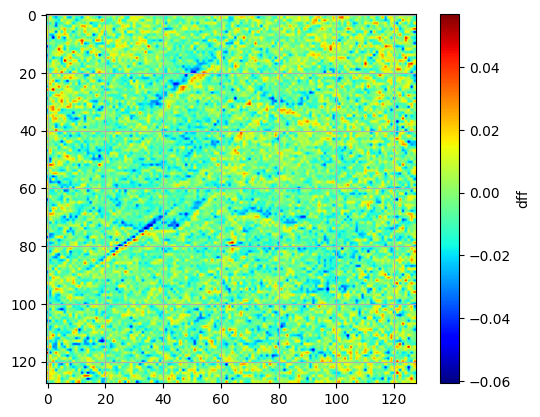

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:41,  3.04it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:37,  3.36it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:34,  3.64it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:33,  3.75it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:33,  3.62it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:35,  3.40it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:34,  3.47it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:37,  3.21it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:36,  3.30it/s]

  8%|██████▎                                                                          | 10/128 [00:02<00:34,  3.42it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:33,  3.51it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:32,  3.54it/s]

 10%|████████▏                                                                        | 13/128 [00:03<00:32,  3.49it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:31,  3.61it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:34,  3.30it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:34,  3.22it/s]

 13%|██████████▊                                                                      | 17/128 [00:04<00:32,  3.37it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:32,  3.42it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:31,  3.47it/s]

 16%|████████████▋                                                                    | 20/128 [00:05<00:30,  3.53it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:30,  3.53it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:29,  3.58it/s]

 18%|██████████████▌                                                                  | 23/128 [00:06<00:31,  3.38it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:31,  3.30it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:29,  3.45it/s]

 20%|████████████████▍                                                                | 26/128 [00:07<00:29,  3.42it/s]

 21%|█████████████████                                                                | 27/128 [00:07<00:28,  3.53it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:28,  3.56it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:28,  3.46it/s]

 23%|██████████████████▉                                                              | 30/128 [00:08<00:28,  3.49it/s]

 24%|███████████████████▌                                                             | 31/128 [00:08<00:27,  3.48it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:29,  3.30it/s]

 26%|████████████████████▉                                                            | 33/128 [00:09<00:28,  3.30it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:09<00:27,  3.38it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:27,  3.41it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:10<00:27,  3.38it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:10<00:27,  3.36it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:25,  3.48it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:11<00:25,  3.47it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:11<00:25,  3.42it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:11<00:24,  3.52it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:12<00:23,  3.62it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:12<00:23,  3.56it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:12<00:23,  3.64it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:12<00:22,  3.66it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:13<00:23,  3.54it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:13<00:22,  3.63it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:13<00:23,  3.38it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:14<00:22,  3.45it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:14<00:22,  3.40it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:14<00:22,  3.44it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:15<00:21,  3.54it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:15<00:20,  3.68it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:15<00:20,  3.68it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:15<00:20,  3.56it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:16<00:20,  3.50it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:16<00:20,  3.49it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:16<00:20,  3.41it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:17<00:19,  3.46it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:17<00:19,  3.48it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:17<00:18,  3.57it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:17<00:19,  3.47it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:18<00:18,  3.57it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:18<00:18,  3.41it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:18<00:18,  3.48it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:18<00:17,  3.57it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:19<00:16,  3.68it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:19<00:16,  3.58it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:19<00:16,  3.55it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:20<00:16,  3.52it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:20<00:15,  3.60it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:20<00:16,  3.43it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:20<00:15,  3.50it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:21<00:15,  3.59it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:21<00:15,  3.38it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:21<00:15,  3.34it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:22<00:14,  3.41it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:22<00:14,  3.38it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:22<00:14,  3.38it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:23<00:14,  3.29it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:23<00:14,  3.20it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:23<00:13,  3.36it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:23<00:13,  3.42it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:24<00:12,  3.38it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:24<00:12,  3.45it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:24<00:12,  3.30it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:25<00:12,  3.24it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:25<00:12,  3.15it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:25<00:11,  3.30it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:26<00:11,  3.40it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:26<00:10,  3.48it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:26<00:09,  3.60it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:26<00:09,  3.59it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:27<00:09,  3.55it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:27<00:09,  3.58it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:27<00:09,  3.51it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:28<00:08,  3.59it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:28<00:08,  3.64it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:28<00:07,  3.71it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:28<00:07,  3.64it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:29<00:07,  3.62it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:29<00:07,  3.67it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:29<00:07,  3.54it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:29<00:06,  3.47it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:30<00:06,  3.55it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:30<00:06,  3.50it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:30<00:05,  3.55it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:31<00:05,  3.56it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:31<00:05,  3.58it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:31<00:05,  3.38it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:31<00:04,  3.50it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:32<00:04,  3.28it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:32<00:04,  3.38it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:32<00:04,  3.46it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:33<00:03,  3.55it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:33<00:03,  3.51it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:33<00:03,  3.31it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:34<00:02,  3.44it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:34<00:02,  3.48it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:34<00:02,  3.31it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:34<00:02,  3.45it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:35<00:01,  3.40it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:35<00:01,  3.47it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:35<00:01,  3.41it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:36<00:00,  3.48it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:36<00:00,  3.50it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:36<00:00,  3.44it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:36<00:00,  3.47it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:36<00:00,  3.47it/s]

frame number 200 plotted


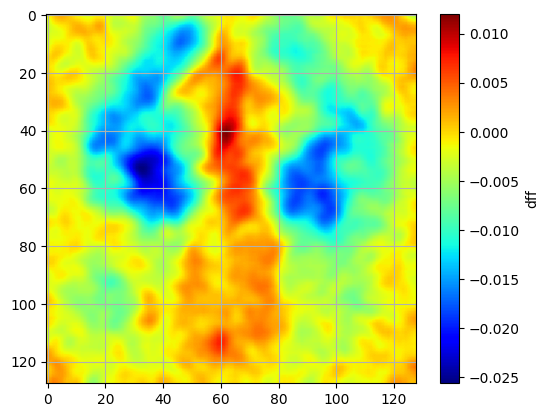

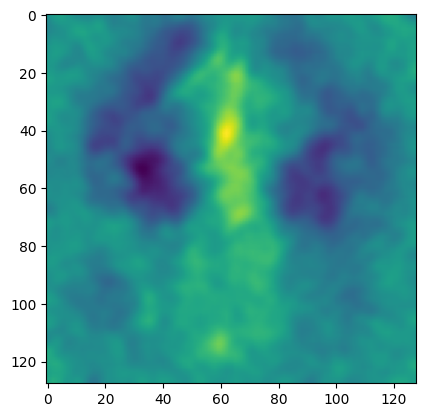

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 22


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 38
fail = 0
total trials = 38


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 30
fail = 10
total trials = 40


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 2
fail = 20
total trials = 22


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/32149 [00:00<?, ?it/s]

  8%|█████▊                                                                    | 2516/32149 [00:00<00:01, 24919.29it/s]

 16%|███████████▊                                                              | 5137/32149 [00:00<00:01, 25530.99it/s]

 24%|█████████████████▊                                                        | 7724/32149 [00:00<00:00, 25675.43it/s]

 32%|███████████████████████▋                                                 | 10412/32149 [00:00<00:00, 26050.38it/s]

 40%|█████████████████████████████▌                                           | 13017/32149 [00:00<00:00, 21526.46it/s]

 49%|███████████████████████████████████▍                                     | 15596/32149 [00:00<00:00, 22730.03it/s]

 57%|█████████████████████████████████████████▊                               | 18388/32149 [00:00<00:00, 24205.65it/s]

 65%|███████████████████████████████████████████████▍                         | 20880/32149 [00:00<00:00, 21858.23it/s]

 73%|█████████████████████████████████████████████████████▏                   | 23433/32149 [00:01<00:00, 22810.14it/s]

 80%|██████████████████████████████████████████████████████████▋              | 25819/32149 [00:01<00:00, 23043.56it/s]

 88%|████████████████████████████████████████████████████████████████▍        | 28384/32149 [00:01<00:00, 23725.07it/s]

 97%|██████████████████████████████████████████████████████████████████████▋  | 31151/32149 [00:01<00:00, 24799.55it/s]

100%|█████████████████████████████████████████████████████████████████████████| 32149/32149 [00:01<00:00, 23909.05it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 20005.27it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25010.76it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")